# Crowding Problem 

## 1. Introduction

Crowd counting problem is to count or estimate the number of people in each image. This will mainly be useful in real-life public monitoring such as Surveillance and traffic control. This will help to prevent calamities stampede could be alleviated, which make great sense for public security. And could be helpful to understand the crowd behavior which could help to improve design of built environment and increase public safety.

Other than public safety measures, Crowd counting problem will also help in commercial business such as malls, stations, bus transportation. This will help to plan and improve the sales businesses day to day basis depends on the number of people visit. 

## 1.1 Business Problem

Predict the number of people in the given image.

## 1.2 Business Objectives and Constraints

* Low Latency requirement
* Errors can be very costly

## 1.3 Sources / Useful Links

* Some of the useful research papers related to Deep Learning approach for Crowd Counting Problem are as follows 

    1.https://arxiv.org/pdf/1912.05765.pdf

    2.https://arxiv.org/pdf/2004.09672.pdf

    3.https://www.mdpi.com/2076-3417/10/14/4781/htm
    
    4.https://arxiv.org/abs/1710.09757
    
    5.https://iopscience.iop.org/article/10.1088/1742-6596/1187/4/042012/pdf

## 1.4 About Dataset Analysis

Below are the provided datasets 

Dataset | Description 
----------|---------------
**`Images.npy `** | This file is a NumPy file which contains 2000 different RGB images of 480X640 pixels.    
**`Frames Folder `**    | This folder contains 2000 RGB images files with 480X640 pixels.
**`Label.csv `**    | This File contains 2000 rows with the id and number of people count.
**`Labels.npy `**    | This is a NumPy file which contains the count of every image (rows and index are ordered)

Below are the features of Label.csv file

Feature | Description 
----------|---------------
**`Id`** | This column contains 2000 row id
**`Count `**    | This column contains people count per image against each “id” column 

# 2. Mapping problem to Deep Learning Problem:

In [1]:
# import supported libraries
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pandas import DataFrame
import operator
from tqdm import tqdm 
from sklearn import preprocessing
from sklearn.datasets import load_digits
from sklearn.feature_selection import SelectKBest, chi2
from scipy.stats import boxcox
import random
import tensorflow_datasets as tfds
import tensorflow as tf

## 2.1 Reading Data 

In [2]:
print(tf.__version__)

2.4.1


In [3]:
AUTOTUNE = tf.data.AUTOTUNE


In [4]:
Crowding_dataset = np.load('images.npy')
print ("Total number of dataset records are :", Crowding_dataset.shape)

Total number of dataset records are : (2000, 480, 640, 3)


In [5]:
labels_dataset = pd.read_csv('labels.csv')
print ("Total number of Training dataset records are :", labels_dataset.shape)

Total number of Training dataset records are : (2000, 2)


In [6]:
type(labels_dataset)

pandas.core.frame.DataFrame

In [7]:
labels_dataset_count = labels_dataset["count"]

In [8]:
labels_dataset_count.head(5)

0    35
1    41
2    41
3    44
4    41
Name: count, dtype: int64

In [9]:
final_dataset_tf = tf.data.Dataset.from_tensor_slices((Crowding_dataset,labels_dataset_count))

In [10]:
(final_dataset_tf)

<TensorSliceDataset shapes: ((480, 640, 3), ()), types: (tf.uint8, tf.int64)>

In [11]:
len((final_dataset_tf))

2000

In [12]:
for element1 in final_dataset_tf:
    print(element1[1])
    #break

tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(44, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(36, shape=(), dtype=int64)
tf.Tensor(27, shape=(), dtype=int64)
tf.Tensor(24, shape=(), dtype=int64)
tf.Tensor(16, shape=(), dtype=int64)
tf.Tensor(22, shape=(), dtype=int64)
tf.Tensor(23, shape=(), dtype=int64)
tf.Tensor(25, shape=(), dtype=int64)
tf.Tensor(15, shape=(), dtype=int64)
tf.Tensor(16, shape=(), dtype=int64)
tf.Tensor(15, shape=(), dtype=int64)
tf.Tensor(25, shape=(), dtype=int64)
tf.Tensor(31, shape=(), dtype=int64)
tf.Tensor(25, shape=(), dtype=int64)
tf.Tensor(24, shape=(), dtype=int64)
tf.Tensor(26, shape=(), dtype=int64)
tf.Tensor(23, shape=(), dtype=int64)
tf.Tensor(23, shape=(), dtype=int64)
tf.Tensor(22, shape=(), dtype=int64)
tf.Tensor(23, shape=(), dtype=int64)
tf.Tensor(21, shape=(), dtype=int64)
t

tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(33, shape=(), dtype=int64)
tf.Tensor(34, shape=(), dtype=int64)
tf.Tensor(30, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(46, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(45, shape=(), dtype=int64)
tf.Tensor(45, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(36, shape=(), dtype=int64)
tf.Tensor(34, shape=(), dtype=int64)
tf.Tensor(28, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(29, shape=(), dtype=int64)
tf.Tensor(31, shape=(), dtype=int64)
tf.Tensor(31, shape=(), dtype=int64)
tf.Tensor(21, shape=(), dtype=int64)
tf.Tensor(21, shape=(), dtype=int64)
tf.Tensor(22, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(36, shape=(), dtype=int64)
tf.Tensor(33, shape=(), dtype=int64)
t

tf.Tensor(23, shape=(), dtype=int64)
tf.Tensor(22, shape=(), dtype=int64)
tf.Tensor(22, shape=(), dtype=int64)
tf.Tensor(24, shape=(), dtype=int64)
tf.Tensor(20, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(17, shape=(), dtype=int64)
tf.Tensor(16, shape=(), dtype=int64)
tf.Tensor(17, shape=(), dtype=int64)
tf.Tensor(13, shape=(), dtype=int64)
tf.Tensor(14, shape=(), dtype=int64)
tf.Tensor(17, shape=(), dtype=int64)
tf.Tensor(17, shape=(), dtype=int64)
tf.Tensor(18, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(18, shape=(), dtype=int64)
tf.Tensor(18, shape=(), dtype=int64)
tf.Tensor(20, shape=(), dtype=int64)
tf.Tensor(20, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(21, shape=(), dtype=int64)
tf.Tensor(23, shape=(), dtype=int64)
tf.Tensor(23, shape=(), dtype=int64)
t

tf.Tensor(48, shape=(), dtype=int64)
tf.Tensor(46, shape=(), dtype=int64)
tf.Tensor(46, shape=(), dtype=int64)
tf.Tensor(43, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
tf.Tensor(44, shape=(), dtype=int64)
tf.Tensor(45, shape=(), dtype=int64)
tf.Tensor(43, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(39, shape=(), dtype=int64)
tf.Tensor(39, shape=(), dtype=int64)
tf.Tensor(40, shape=(), dtype=int64)
tf.Tensor(36, shape=(), dtype=int64)
tf.Tensor(37, shape=(), dtype=int64)
tf.Tensor(38, shape=(), dtype=int64)
tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(36, shape=(), dtype=int64)
tf.Tensor(38, shape=(), dtype=int64)
tf.Tensor(38, shape=(), dtype=int64)
tf.Tensor(40, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
tf.Tensor(43, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
t

tf.Tensor(30, shape=(), dtype=int64)
tf.Tensor(31, shape=(), dtype=int64)
tf.Tensor(33, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(36, shape=(), dtype=int64)
tf.Tensor(37, shape=(), dtype=int64)
tf.Tensor(34, shape=(), dtype=int64)
tf.Tensor(34, shape=(), dtype=int64)
tf.Tensor(37, shape=(), dtype=int64)
tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(30, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(34, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(31, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(27, shape=(), dtype=int64)
tf.Tensor(25, shape=(), dtype=int64)
tf.Tensor(30, shape=(), dtype=int64)
tf.Tensor(29, shape=(), dtype=int64)
tf.Tensor(28, shape=(), dtype=int64)
tf.Tensor(29, shape=(), dtype=int64)
tf.Tensor(31, shape=(), dtype=int64)
tf.Tensor(31, shape=(), dtype=int64)
tf.Tensor(32, shape=(), dtype=int64)
t

tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(17, shape=(), dtype=int64)
tf.Tensor(18, shape=(), dtype=int64)
tf.Tensor(20, shape=(), dtype=int64)
tf.Tensor(20, shape=(), dtype=int64)
tf.Tensor(20, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(19, shape=(), dtype=int64)
tf.Tensor(22, shape=(), dtype=int64)
tf.Tensor(22, shape=(), dtype=int64)
tf.Tensor(21, shape=(), dtype=int64)
tf.Tensor(25, shape=(), dtype=int64)
tf.Tensor(28, shape=(), dtype=int64)
tf.Tensor(30, shape=(), dtype=int64)
tf.Tensor(29, shape=(), dtype=int64)
tf.Tensor(26, shape=(), dtype=int64)
tf.Tensor(27, shape=(), dtype=int64)
tf.Tensor(27, shape=(), dtype=int64)
tf.Tensor(30, shape=(), dtype=int64)
tf.Tensor(27, shape=(), dtype=int64)
tf.Tensor(29, shape=(), dtype=int64)
tf.Tensor(26, shape=(), dtype=int64)
tf.Tensor(28, shape=(), dtype=int64)
tf.Tensor(27, shape=(), dtype=int64)
tf.Tensor(25, shape=(), dtype=int64)
tf.Tensor(23, shape=(), dtype=int64)
t

tf.Tensor(32, shape=(), dtype=int64)
tf.Tensor(27, shape=(), dtype=int64)
tf.Tensor(29, shape=(), dtype=int64)
tf.Tensor(30, shape=(), dtype=int64)
tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(40, shape=(), dtype=int64)
tf.Tensor(41, shape=(), dtype=int64)
tf.Tensor(44, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
tf.Tensor(36, shape=(), dtype=int64)
tf.Tensor(37, shape=(), dtype=int64)
tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(40, shape=(), dtype=int64)
tf.Tensor(40, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
tf.Tensor(45, shape=(), dtype=int64)
tf.Tensor(42, shape=(), dtype=int64)
tf.Tensor(39, shape=(), dtype=int64)
tf.Tensor(33, shape=(), dtype=int64)
tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(39, shape=(), dtype=int64)
tf.Tensor(33, shape=(), dtype=int64)
tf.Tensor(33, shape=(), dtype=int64)
tf.Tensor(35, shape=(), dtype=int64)
tf.Tensor(31, shape=(), dtype=int64)
tf.Tensor(30, shape=(), dtype=int64)
t

In [13]:
print('People Count : ' , labels_dataset['count'][0])

People Count :  35


In [14]:
Crowding_dataset[0]

array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       ...,

       [[150, 118,  95],
        [151, 119,  96],
        [151, 119,  96],
        ...,
        [201, 156, 115],
        [204, 159, 117],
        [205, 161, 116]],

       [[152, 120,  97],
        [152, 120,  97],
        [152, 120,  97],
        ...,
        [188, 143, 102],
        [191, 146, 104],
        [192, 148, 103]],

       [[152, 120,  97],
        [151, 119,  96],
        [151, 119,  96],
        ...,
        [178, 133,  92],
        [175, 130,  88],
        [172, 128,  83]]

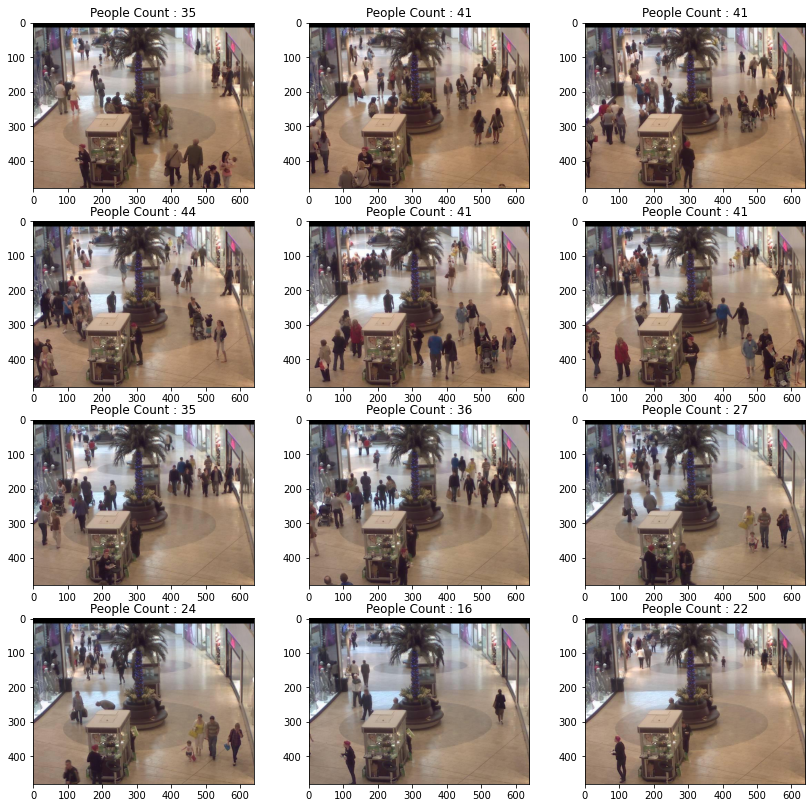

In [15]:
#https://stackoverflow.com/questions/33480297/viewing-npy-images
fig = plt.figure(figsize=(14,14))
a = 4  # number of rows
b = 3 # number of columns
c = 1  # initialize plot counter
for number in range(0,12):
    plt.subplot(a, b, c)
    plt.imshow(Crowding_dataset[number], cmap='gray')
    plt.title("People Count : {0}".format(labels_dataset['count'][number]))
    c=c+1
plt.show()

# 3. EDA Analysis

In [16]:
labels_dataset.describe()

,id,count
count,2000.000000,2000.000000
mean,1000.500000,31.157500
std,577.494589,6.945417
min,1.000000,13.000000
25%,500.750000,26.000000
50%,1000.500000,31.000000
75%,1500.250000,36.000000
max,2000.000000,53.000000


Text(0, 0.5, 'Number of Images')

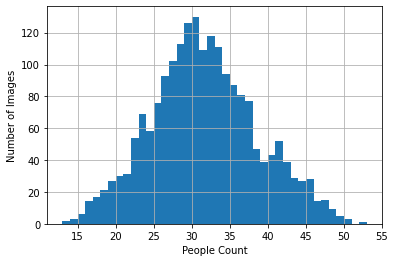

In [17]:
labels_dataset['count'].hist(bins=40)
plt.xlabel("People Count")
plt.ylabel("Number of Images")

<b> Observation: </b>
    
Above plot results represents a Bell shape (Gaussian) Distribution. Noticed that, out of 2000 images, People Count lies between 37 to 33 has more number of images.

Lets split the images in to low, medium and high categories

In [18]:
lowcount_imagesIndexes=[index for index, value in enumerate(labels_dataset['count']) if value <= 20 ]
len(lowcount_imagesIndexes)
mediumcount_imagesIndexes=[index for index, value in enumerate(labels_dataset['count']) if (value) <= 40 and (value) >=21 ]
highcount_imagesIndexes=[index for index, value in enumerate(labels_dataset['count']) if (value) <= 60 and (value) >=41 ]

## Plot Low People count Images

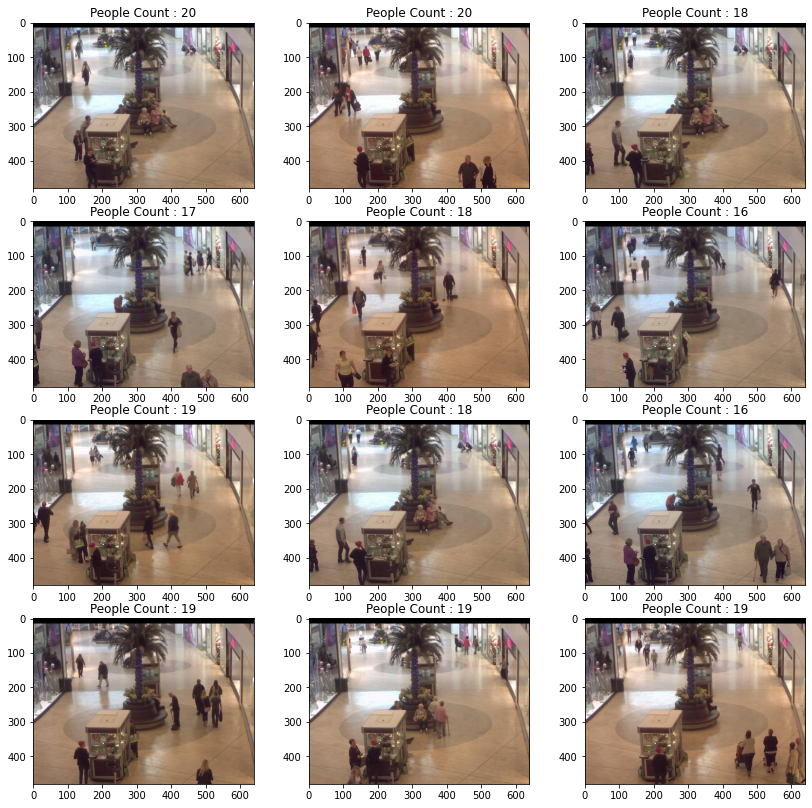

In [19]:
#https://stackoverflow.com/questions/33480297/viewing-npy-images
fig = plt.figure(figsize=(14,14))
a = 4  # number of rows
b = 3 # number of columns
c = 1  # initialize plot counter
for num in range(0,12):
    plt.subplot(a, b, c)
    number = random.choice(lowcount_imagesIndexes)
    plt.imshow(Crowding_dataset[number], cmap='gray')
    plt.title("People Count : {0}".format(labels_dataset['count'][number]))
    c=c+1
plt.show()

## Plot Medium People count Images

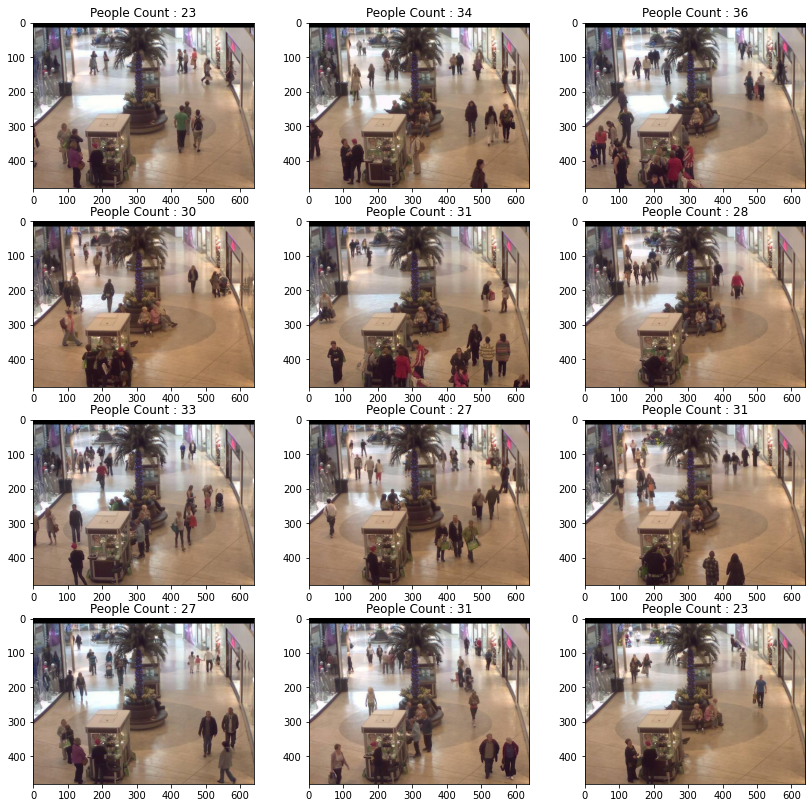

In [20]:
#https://stackoverflow.com/questions/33480297/viewing-npy-images
fig = plt.figure(figsize=(14,14))
a = 4  # number of rows
b = 3 # number of columns
c = 1  # initialize plot counter
for num in range(0,12):
    plt.subplot(a, b, c)
    number = random.choice(mediumcount_imagesIndexes)
    plt.imshow(Crowding_dataset[number], cmap='gray')
    plt.title("People Count : {0}".format(labels_dataset['count'][number]))
    c=c+1
plt.show()

## Plot High People count Images

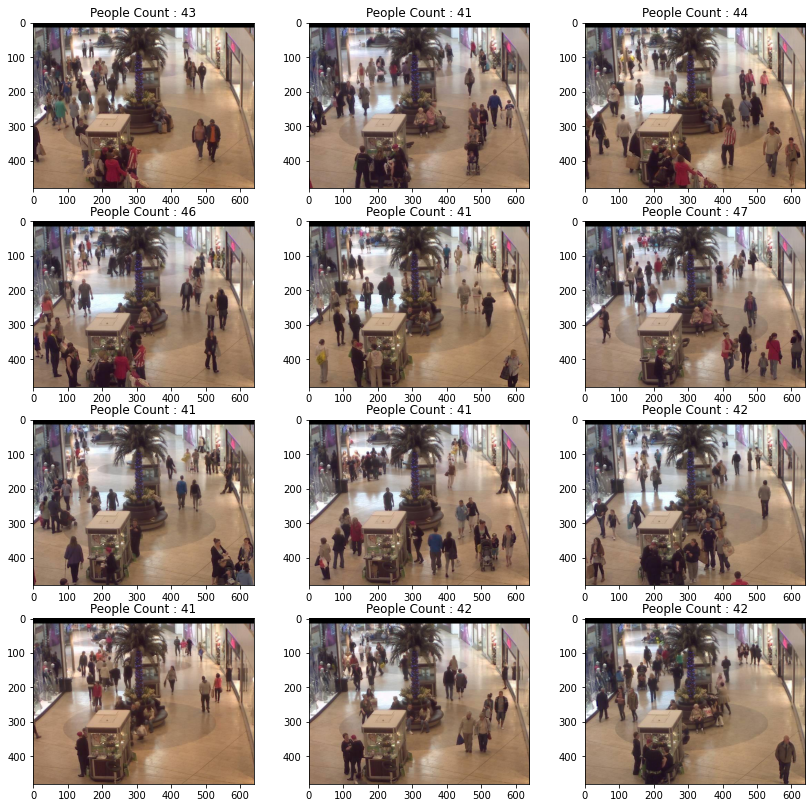

In [21]:
#https://stackoverflow.com/questions/33480297/viewing-npy-images
fig = plt.figure(figsize=(14,14))
a = 4  # number of rows
b = 3 # number of columns
c = 1  # initialize plot counter
for num in range(0,12):
    plt.subplot(a, b, c)
    number = random.choice(highcount_imagesIndexes)
    plt.imshow(Crowding_dataset[number], cmap='gray')
    plt.title("People Count : {0}".format(labels_dataset['count'][number]))
    c=c+1
plt.show()

In [22]:
labels_dataset

,id,count
0,1,35
1,2,41
2,3,41
3,4,44
4,5,41
...,...,...
1995,1996,27
1996,1997,27
1997,1998,25
1998,1999,26


# 4. Apply DL Models

<h2>Splitting data into Train and cross validation(or test)</h2>

In [23]:
val_size = 1600
X_train = final_dataset_tf.take(val_size)
X_test = final_dataset_tf.skip(val_size)

In [24]:
X_train_org= final_dataset_tf.take(val_size)
X_test_org= final_dataset_tf.skip(val_size)

In [25]:
print(tf.data.experimental.cardinality(X_train).numpy())
print(tf.data.experimental.cardinality(X_test).numpy())

1600
400


In [26]:
y_train_count = []
y_test_count = []
for element2 in X_train:
    y_train_count.append(element2[1])
    #break
    
for element1 in X_test:
    y_test_count.append(element1[1])
    #break
print(y_test_count)

[<tf.Tensor: shape=(), dtype=int64, numpy=34>, <tf.Tensor: shape=(), dtype=int64, numpy=31>, <tf.Tensor: shape=(), dtype=int64, numpy=32>, <tf.Tensor: shape=(), dtype=int64, numpy=35>, <tf.Tensor: shape=(), dtype=int64, numpy=32>, <tf.Tensor: shape=(), dtype=int64, numpy=34>, <tf.Tensor: shape=(), dtype=int64, numpy=37>, <tf.Tensor: shape=(), dtype=int64, numpy=39>, <tf.Tensor: shape=(), dtype=int64, numpy=40>, <tf.Tensor: shape=(), dtype=int64, numpy=45>, <tf.Tensor: shape=(), dtype=int64, numpy=45>, <tf.Tensor: shape=(), dtype=int64, numpy=45>, <tf.Tensor: shape=(), dtype=int64, numpy=47>, <tf.Tensor: shape=(), dtype=int64, numpy=47>, <tf.Tensor: shape=(), dtype=int64, numpy=44>, <tf.Tensor: shape=(), dtype=int64, numpy=41>, <tf.Tensor: shape=(), dtype=int64, numpy=38>, <tf.Tensor: shape=(), dtype=int64, numpy=43>, <tf.Tensor: shape=(), dtype=int64, numpy=43>, <tf.Tensor: shape=(), dtype=int64, numpy=42>, <tf.Tensor: shape=(), dtype=int64, numpy=39>, <tf.Tensor: shape=(), dtype=int64

<h2>Preprocessing</h2>

In [27]:
seed=(1,2)
def preprocess_image(image,count):
    #image,count = image,count
    image = tf.cast(image, tf.float32)
    image = tf.image.resize(image, [400, 400])  #resizing the image to 400X400 pixels
    image = tf.image.random_flip_left_right(image) #fliping the image left to right
    image = tf.image.stateless_random_flip_up_down(image,seed) #flipping the image upside down

    image = tf.image.stateless_random_brightness(image, max_delta=32.0 / 255.0, seed=seed) #Randomly changing the brightness to the images
    image = tf.image.stateless_random_saturation(image, lower=0.5, upper=1.5, seed=seed) #Randomly changing saturation to the images

    return image,count


In [28]:
X_train = X_train.map(preprocess_image, num_parallel_calls=AUTOTUNE)
X_test = X_test.map(preprocess_image, num_parallel_calls=AUTOTUNE)

In [29]:
X_train

<ParallelMapDataset shapes: ((400, 400, 3), ()), types: (tf.float32, tf.int64)>

In [30]:
for element in X_train:
    print(element[1])
    break

tf.Tensor(35, shape=(), dtype=int64)


In [31]:
y_test_count[0]

<tf.Tensor: shape=(), dtype=int64, numpy=34>

In [32]:
y_test_count[2].numpy().astype("uint8")

32

In [33]:
#converting to list
y_test_count_actual=[]
for i in range (0,400) :
    y_test_count_actual.append(y_test_count[i].numpy().astype("uint8"))
    
    
#converting to list
y_train_count_actual=[]
for i in range (0,1600) :
    y_train_count_actual.append(y_train_count[i].numpy().astype("uint8"))

In [34]:
y_test_count_actual

[34,
 31,
 32,
 35,
 32,
 34,
 37,
 39,
 40,
 45,
 45,
 45,
 47,
 47,
 44,
 41,
 38,
 43,
 43,
 42,
 39,
 37,
 37,
 34,
 34,
 34,
 33,
 33,
 31,
 33,
 29,
 27,
 27,
 28,
 33,
 34,
 37,
 34,
 39,
 34,
 39,
 37,
 33,
 37,
 42,
 39,
 40,
 39,
 38,
 41,
 40,
 43,
 42,
 45,
 45,
 47,
 45,
 46,
 46,
 44,
 38,
 34,
 32,
 33,
 32,
 28,
 25,
 23,
 22,
 23,
 25,
 26,
 29,
 29,
 30,
 30,
 29,
 31,
 30,
 32,
 34,
 33,
 33,
 32,
 30,
 28,
 30,
 36,
 35,
 35,
 30,
 29,
 29,
 32,
 34,
 35,
 31,
 29,
 28,
 27,
 31,
 29,
 36,
 35,
 37,
 30,
 32,
 33,
 37,
 37,
 33,
 40,
 43,
 43,
 42,
 45,
 44,
 41,
 45,
 43,
 40,
 40,
 44,
 44,
 44,
 44,
 44,
 41,
 45,
 48,
 47,
 44,
 38,
 43,
 39,
 40,
 38,
 34,
 37,
 35,
 33,
 36,
 32,
 27,
 29,
 27,
 30,
 28,
 31,
 28,
 28,
 27,
 28,
 32,
 30,
 32,
 30,
 30,
 26,
 26,
 23,
 25,
 27,
 26,
 25,
 24,
 22,
 20,
 20,
 20,
 21,
 21,
 26,
 27,
 30,
 30,
 34,
 29,
 30,
 29,
 31,
 35,
 34,
 36,
 37,
 38,
 31,
 28,
 27,
 25,
 27,
 27,
 32,
 31,
 26,
 25,
 28,
 28,
 30,
 33,


In [35]:
def configure_for_performance(ds):
    ds = ds.cache()
    ds = ds.shuffle(buffer_size=1000)
    ds = ds.batch(batch_size)
    ds = ds.prefetch(buffer_size=AUTOTUNE)
    return ds

In [36]:
batch_size=32
input_shape=(400, 400,3)

In [37]:
X_train = configure_for_performance(X_train)
X_test = configure_for_performance(X_test)

<h2>Display the images after Preprocess </h2>

In [38]:
image_batch, label_batch = next(iter(X_train))


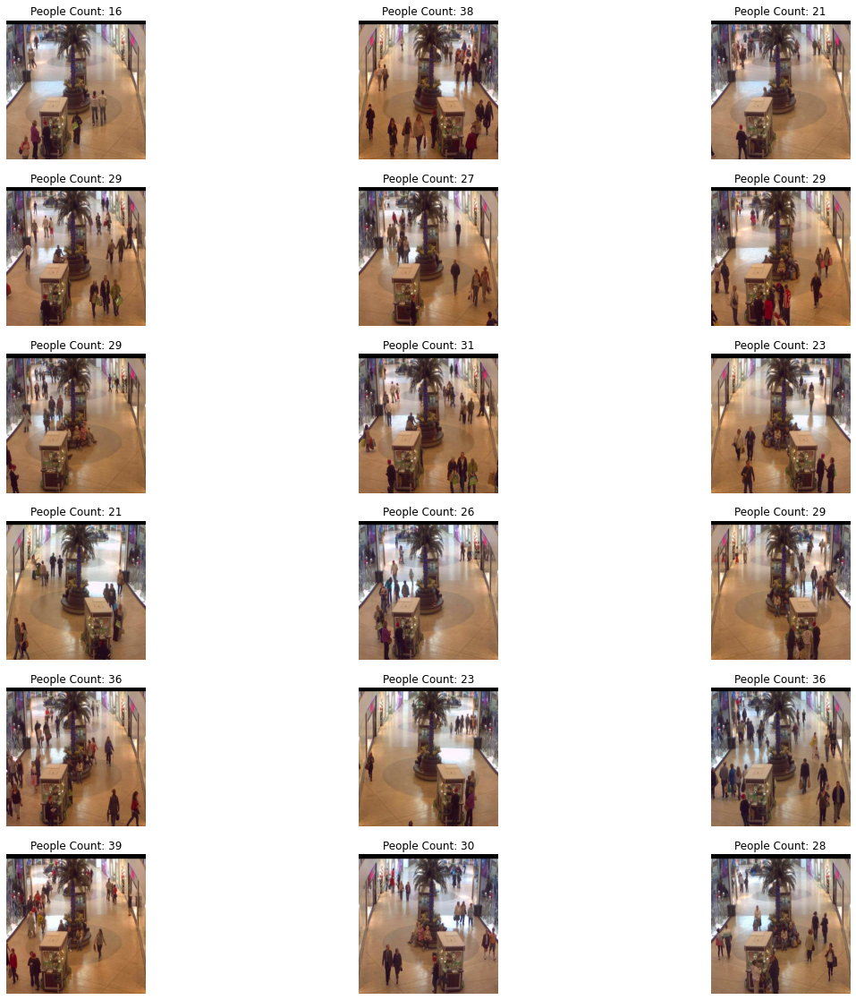

In [39]:
plt.figure(figsize=(20, 20))
for i in range(18):
    ax = plt.subplot(6, 3, i + 1)
    plt.imshow(image_batch[i].numpy().astype("uint8"))
    #label = label_batch[i]
    plt.title("People Count: "+str(label_batch[i].numpy().astype("uint8")))
    plt.axis("off")
    
    


In [40]:
len(image_batch)

32

## 4.1 Model 1: C-CNN Architecture

Implement below architecture to predict people count

<img src="Arch1.png">

In [41]:
# Importing tensorflow
np.random.seed(42)
import tensorflow as tf
#tf.set_random_seed(42)
tf.random.set_seed(42)

In [42]:
# Configuring a session
session_conf = tf.compat.v1.ConfigProto(
    intra_op_parallelism_threads=3,
    inter_op_parallelism_threads=3
)

In [43]:
# Import Keras
from keras import backend as K
sess = tf.compat.v1.Session(graph=tf.compat.v1.get_default_graph(), config=session_conf)
#K.set_session(sess)
tf.compat.v1.keras.backend.set_session(sess)



In [44]:
from keras import Input, Model, Sequential
#from keras.layers import Conv2D, MaxPooling2D, Concatenate, Activation, Dropout, Flatten, Dense
from tensorflow.keras.layers import Conv2D,Dense,concatenate,Activation,Dropout,Input


In [49]:
#Input layer
input_layer = Input(shape=input_shape)

#Convolution Parallel layer 1
Conv_Layer_1 = tf.keras.layers.Conv2D(10, kernel_size=(9, 9), padding='same',activation='relu', input_shape=input_shape)(input_layer)
inputlayer_1_pooling = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(Conv_Layer_1)
inputlayer_1_pooling1= tf.keras.layers.Dropout(0.25)(inputlayer_1_pooling)

#Convolution Parallel layer 2
Conv_Layer_2 = tf.keras.layers.Conv2D(14, kernel_size=(7, 7),padding='same',activation='relu', input_shape=input_shape)(input_layer)
inputlayer_2_pooling = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(Conv_Layer_2)
inputlayer_2_pooling1= tf.keras.layers.Dropout(0.25)(inputlayer_2_pooling)

#Convolution Parallel layer 3
Conv_Layer_3 = tf.keras.layers.Conv2D(16, kernel_size=(5, 5),padding='same',activation='relu', input_shape=input_shape)(input_layer)
inputlayer_3_pooling = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(Conv_Layer_3)
inputlayer_3_pooling1= tf.keras.layers.Dropout(0.25)(inputlayer_3_pooling)


In [50]:
#Perform concantenation of all three parallel layers
concatenation_layer = concatenate(inputs=[inputlayer_1_pooling1
                                   ,inputlayer_2_pooling1,inputlayer_3_pooling1
                                  ],name="concat")

In [51]:
#Add 6 convolutional layers as per above architecture

convlayer2 = tf.keras.layers.Conv2D(40, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(concatenation_layer)
convlayer2_1= tf.keras.layers.BatchNormalization()(convlayer2)

convlayer3 = tf.keras.layers.Conv2D(60, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(convlayer2_1)
polling_layer3_1= tf.keras.layers.Dropout(0.25)(convlayer3)
convlayer3_1= tf.keras.layers.BatchNormalization()(polling_layer3_1)
polling_layer3 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(convlayer3_1)


convlayer4 = tf.keras.layers.Conv2D(40, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(polling_layer3)
polling_layer4_1= tf.keras.layers.Dropout(0.25)(convlayer4)
convlayer4_1= tf.keras.layers.BatchNormalization()(polling_layer4_1)
polling_layer4 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(convlayer4_1)


convlayer5 = tf.keras.layers.Conv2D(20, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(polling_layer4)
polling_layer5_1= tf.keras.layers.Dropout(0.25)(convlayer5)
convlayer5_1= tf.keras.layers.BatchNormalization()(polling_layer5_1)


convlayer6 = tf.keras.layers.Conv2D(10, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(convlayer5_1)
polling_layer6_1= tf.keras.layers.Dropout(0.25)(convlayer6)
convlayer6_1= tf.keras.layers.BatchNormalization()(polling_layer6_1)

flatten = tf.keras.layers.Flatten()(convlayer6_1)
#denss1 = tf.keras.layers.Dense(128, activation=tf.keras.activations.relu)(flatten)
output = tf.keras.layers.Dense(1)(flatten)

In [52]:
from tensorflow.keras.models import Model

final_model = Model(inputs=input_layer,outputs=output)


In [53]:
final_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 400, 400, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 400, 400, 10) 2440        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 400, 400, 14) 2072        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 400, 400, 16) 1216        input_1[0][0]                    
______________________________________________________________________________________________

In [54]:
# Compiling the model
final_model.compile(loss='mean_squared_error', optimizer=tf.keras.optimizers.Adam(lr=1e-6), metrics=['mae','mse']
              )

In [56]:
epochs=50

In [78]:
from tensorflow.keras.callbacks import ModelCheckpoint
from time import time
from tensorflow.python.keras.callbacks import TensorBoard
monitor= tf.keras.callbacks.EarlyStopping(monitor=['mae','mse'],patience=5, verbose=1, mode='auto')
checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath="./Model_1.hdf5",verbose=1,monitor='val_mae',save_best_only=True,save_freq='epoch')
tensorboard=TensorBoard(log_dir="Model1_log1")


Model1 = final_model.fit(X_train,
          #batch_size=32,
          epochs=epochs,
          verbose=1,
          validation_data=(X_test),
          callbacks=[tensorboard,checkpointer] 
          #callbacks=[ModelCheckpoint('./Model_1.hdf5', monitor='mae', verbose=1,
          #save_best_only=True,  save_freq='epoch')]
            )

Epoch 1/50
50/50 [==============================] - 44s 850ms/step - loss: 1020.0391 - mae: 31.0522 - mse: 1020.0391 - val_loss: 1140.8021 - val_mae: 33.2539 - val_mse: 1140.8021

Epoch 00001: val_mae improved from inf to 33.25388, saving model to ./Model_1.hdf5
Epoch 2/50
50/50 [==============================] - 42s 838ms/step - loss: 1011.0675 - mae: 30.9241 - mse: 1011.0675 - val_loss: 1100.5089 - val_mae: 32.6410 - val_mse: 1100.5089

Epoch 00002: val_mae improved from 33.25388 to 32.64098, saving model to ./Model_1.hdf5
Epoch 3/50
50/50 [==============================] - 42s 834ms/step - loss: 997.3741 - mae: 30.6281 - mse: 997.3741 - val_loss: 1071.5652 - val_mae: 32.1922 - val_mse: 1071.5652

Epoch 00003: val_mae improved from 32.64098 to 32.19215, saving model to ./Model_1.hdf5
Epoch 4/50
50/50 [==============================] - 42s 837ms/step - loss: 1000.2121 - mae: 30.7948 - mse: 1000.2121 - val_loss: 1055.0433 - val_mae: 31.9347 - val_mse: 1055.0433

Epoch 00004: val_mae im

<b> Observation: </b>
    
Observed that, Loss and mae is reducing for every epoch. At epoch 50, results are pretty bad.

In [57]:
final_model.load_weights('./Model_1.hdf5')

In [58]:
#Predict the output
y_test_results_model1 = final_model.predict(X_test)
y_train_results_model1 = final_model.predict(X_train)

len(y_train_results_model1)

1600

## Tensorboard Model 1

<img src="Model1_Tensorboard.png">

In [82]:
#add to the dataframe
Model1_Train_results = pd.DataFrame()
Model1_Train_results['Train_Actual']= y_train_count_actual
Model1_Train_results['Train_Predicted']= np.round(y_train_results_model1)
Model1_Train_results['Train_Difference(actual-predicted)']  = Model1_Train_results['Train_Actual'] - Model1_Train_results['Train_Predicted']
Model1_Train_results['index_column'] = Model1_Train_results.index

Model1_Test_results = pd.DataFrame()
Model1_Test_results['Test_Actual']= y_test_count_actual
Model1_Test_results['Test_Predicted']= np.round(y_test_results_model1)
#Model1_results['difference'] = y_Test_count_actual-y_Test_results_Model1
Model1_Test_results['Test_Difference(actual-predicted)']  = Model1_Test_results['Test_Actual'] - Model1_Test_results['Test_Predicted']
Model1_Test_results['index_column'] = Model1_Test_results.index
Model1_Test_results.head(10)

,Test_Actual,Test_Predicted,Test_Difference(actual-predicted),index_column
0,34,8.0,26.0,0
1,31,8.0,23.0,1
2,32,7.0,25.0,2
3,35,8.0,27.0,3
4,32,7.0,25.0,4
5,34,8.0,26.0,5
6,37,7.0,30.0,6
7,39,8.0,31.0,7
8,40,8.0,32.0,8
9,45,9.0,36.0,9


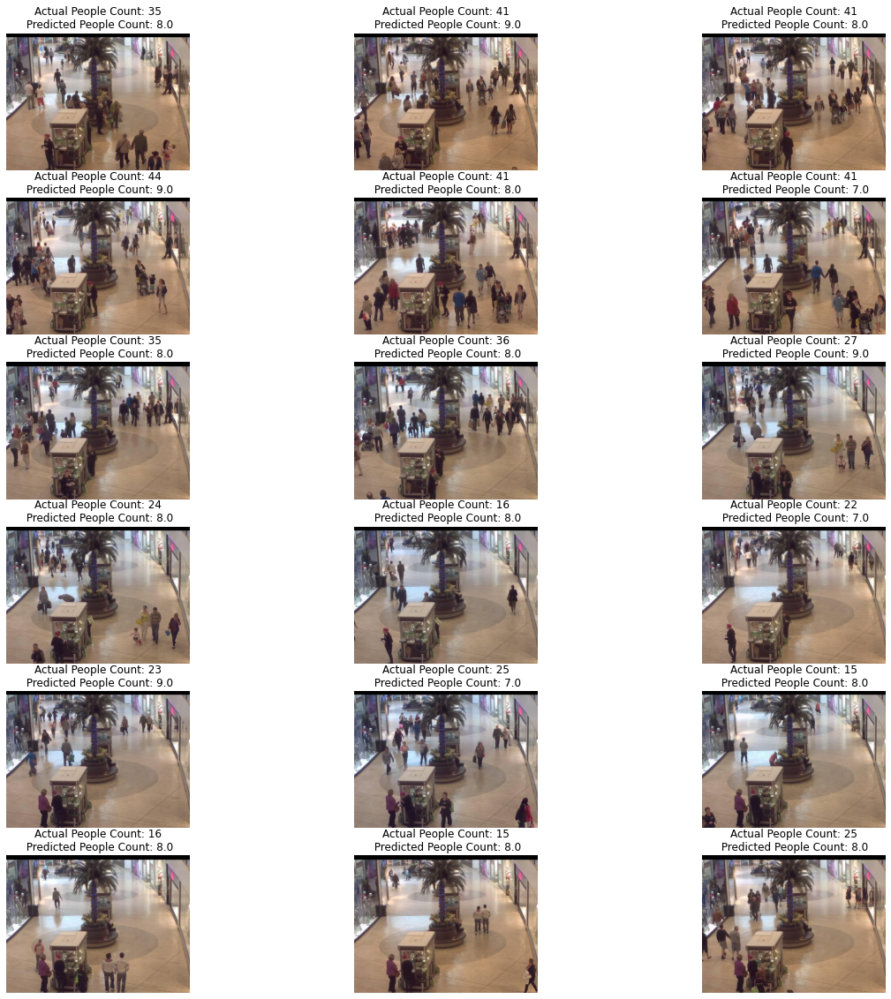

In [60]:
#Print Train Actual vs Predict

plt.figure(figsize=(20, 20))
i=0
for element15 in X_train_org:
    ax = plt.subplot(6, 3, i + 1)
    plt.imshow(element15[0].numpy().astype("uint8"))
    #label = label_batch[i]
    #plt.title("Actual People Count: "+str(Model2_results['actual'][i]))
    plt.title("Actual People Count: "+str(Model1_Train_results['Train_Actual'][i])+ "\n Predicted People Count: "+str(Model1_Train_results['Train_Predicted'][i]))
    plt.axis("off")
    i+=1
    if i>17:
        break
plt.show;
    

<function matplotlib.pyplot.show>

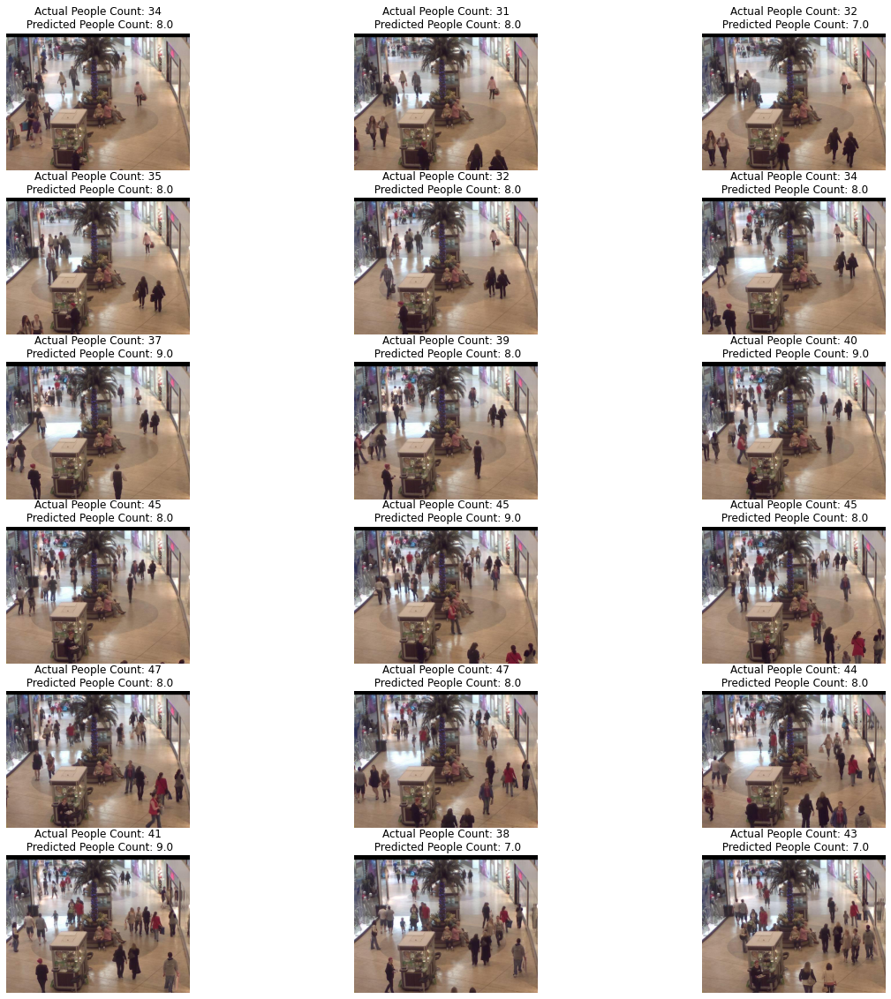

In [61]:
#Print Test Actual vs Predict

plt.figure(figsize=(20, 20))
i=0
for element15 in X_test_org:
    ax = plt.subplot(6, 3, i + 1)
    plt.imshow(element15[0].numpy().astype("uint8"))
    #label = label_batch[i]
    #plt.title("Actual People Count: "+str(Model2_results['actual'][i]))
    plt.title("Actual People Count: "+str(Model1_Test_results['Test_Actual'][i])+ "\n Predicted People Count: "+str(Model1_Test_results['Test_Predicted'][i]))
    plt.axis("off")
    i+=1
    if i>17:
        break
plt.show
    

In [62]:
#Pick top 5 rows which has more prediction margin in Train dataset
Model1_Train_results_sort = Model1_Train_results.sort_values('Train_Difference(actual-predicted)', ascending=False)
Model1_Train_results_sort.head(5)

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,8.0,45.0,180
1182,50,8.0,42.0,1182
764,50,8.0,42.0,764
763,49,7.0,42.0,763
722,50,8.0,42.0,722


In [63]:
Top_least_predicted_Model1 = Model1_Train_results_sort[0:5].sort_values('index_column', ascending=True)
Top_least_predicted_Model1

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,8.0,45.0,180
722,50,8.0,42.0,722
763,49,7.0,42.0,763
764,50,8.0,42.0,764
1182,50,8.0,42.0,1182


## 4.2 Model 2

Lets implement "CNN + MaxPooling + Batch Normalization + Dropout + ReLu with two Hiden Layer" Architecture

In [64]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.Conv2D(32, kernel_size=(3, 3),
                 activation='relu',
                 input_shape=input_shape))


model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.Dense(64, activation='relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.5))

model.add(tf.keras.layers.Conv2D(128, (3, 3), activation='relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))


model.add(tf.keras.layers.Dense(128, activation='relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.5))


model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(1))


In [65]:
model.compile(loss='mean_squared_error', optimizer=tf.keras.optimizers.Adam(lr=1e-6), metrics=['mae','mse']
              )

In [66]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 398, 398, 32)      896       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 396, 396, 64)      18496     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 198, 198, 64)      0         
_________________________________________________________________
batch_normalization (BatchNo (None, 198, 198, 64)      256       
_________________________________________________________________
dropout (Dropout)            (None, 198, 198, 64)      0         
_________________________________________________________________
dense (Dense)                (None, 198, 198, 64)      4160      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 99, 99, 64)        0

In [91]:
from tensorflow.keras.callbacks import ModelCheckpoint


from tensorflow.keras.callbacks import ModelCheckpoint
from time import time
from tensorflow.python.keras.callbacks import TensorBoard
#monitor= tf.keras.callbacks.EarlyStopping(monitor=['mae'],patience=5, verbose=1, mode='auto')
checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath="./Model_2.hdf5",verbose=1,monitor='val_mae',save_best_only=True,save_freq='epoch')
tensorboard=TensorBoard(log_dir="Model2_log")


Model_2 = model.fit(X_train,
          #batch_size=32,
          epochs=epochs,
          verbose=1,
          validation_data=(X_test),
          callbacks=[tensorboard,checkpointer] 
          #callbacks=[ModelCheckpoint('./Model_2.hdf5', monitor='mae', verbose=1,
          #save_best_only=True,  save_freq='epoch')]
            )

Epoch 1/50
50/50 [==============================] - 56s 1s/step - loss: 946.8108 - mae: 29.8556 - mse: 946.8108 - val_loss: 1045.2692 - val_mae: 31.7739 - val_mse: 1045.2692

Epoch 00001: val_mae improved from inf to 31.77388, saving model to ./Model_2.hdf5
Epoch 2/50
50/50 [==============================] - 48s 953ms/step - loss: 905.1755 - mae: 29.1036 - mse: 905.1755 - val_loss: 1010.1243 - val_mae: 31.2148 - val_mse: 1010.1243

Epoch 00002: val_mae improved from 31.77388 to 31.21475, saving model to ./Model_2.hdf5
Epoch 3/50
50/50 [==============================] - 48s 956ms/step - loss: 817.7425 - mae: 27.5798 - mse: 817.7425 - val_loss: 952.1516 - val_mae: 30.2718 - val_mse: 952.1516

Epoch 00003: val_mae improved from 31.21475 to 30.27184, saving model to ./Model_2.hdf5
Epoch 4/50
50/50 [==============================] - 47s 946ms/step - loss: 773.0982 - mae: 26.7346 - mse: 773.0982 - val_loss: 891.4151 - val_mae: 29.2494 - val_mse: 891.4151

Epoch 00004: val_mae improved from 3

<b> Observation: </b>
    
- Observed that, Loss and mae is reducing for every epoch. At epoch 50, results are pretty bad.
- Model 2 provided better results when compared with model 1.


In [70]:
epochs=50

In [71]:
model.load_weights('./Model_2.hdf5')

#Predict the output

y_test_results_model2 = model.predict(X_test)
y_train_results_model2 = model.predict(X_train)

len(y_train_results_model2)

1600

In [72]:
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import time
# https://gist.github.com/greydanus/f6eee59eaf1d90fcb3b534a25362cea4
# https://stackoverflow.com/a/14434334
# this function is used to update the plots for each epoch and error
def plt_dynamic(x, vy, ty, ax, colors=['b']):
    ax.plot(x, vy, 'b', label="Validation")
    ax.plot(x, ty, 'r', label="Train")
    plt.legend()
    plt.grid()
    fig.canvas.draw()

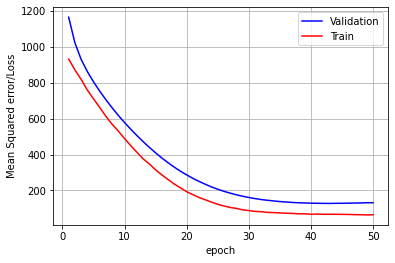

In [72]:
%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import time
# https://gist.github.com/greydanus/f6eee59eaf1d90fcb3b534a25362cea4
# https://stackoverflow.com/a/14434334
# this function is used to update the plots for each epoch and error
def plt_dynamic(x, vy, ty, ax, colors=['b']):
    ax.plot(x, vy, 'b', label="Validation")
    ax.plot(x, ty, 'r', label="Train")
    plt.legend()
    plt.grid()
    fig.canvas.draw()


fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') ; ax.set_ylabel('Mean Squared error/Loss')

# list of epoch numbers
x = list(range(1,epochs+1))
vy = Model_2.history['val_mse']
ty = Model_2.history['mse']
plt_dynamic(x, vy, ty, ax)

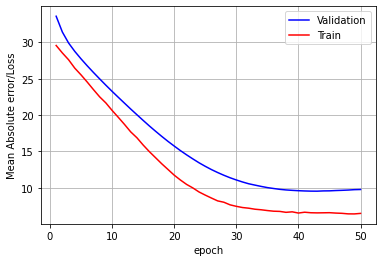

In [73]:
fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') ; ax.set_ylabel('Mean Absolute error/Loss')

# list of epoch numbers
x = list(range(1,epochs+1))
vy = Model_2.history['val_mae']
ty = Model_2.history['mae']
plt_dynamic(x, vy, ty, ax)

## Tensorboard Model 2

<img src="Model2_Tensorboard.png">

In [73]:
print(len(y_train_results_model2))
print(len(y_train_count_actual))

1600
1600


In [74]:
#add to the dataframe
Model2_Train_results = pd.DataFrame()
Model2_Train_results['Train_Actual']= y_train_count_actual
Model2_Train_results['Train_Predicted']= np.round(y_train_results_model2)
Model2_Train_results['Train_Difference(actual-predicted)']  = Model2_Train_results['Train_Actual'] - Model2_Train_results['Train_Predicted']
Model2_Train_results['Train_Difference(actual-predicted)'] = Model2_Train_results['Train_Difference(actual-predicted)'].abs()
Model2_Train_results['index_column'] = Model2_Train_results.index

Model2_Test_results = pd.DataFrame()
Model2_Test_results['Test_Actual']= y_test_count_actual
Model2_Test_results['Test_Predicted']= np.round(y_test_results_model2)
#Model2_results['difference'] = y_Test_count_actual-y_Test_results_model2
Model2_Test_results['Test_Difference(actual-predicted)']  = Model2_Test_results['Test_Actual'] - Model2_Test_results['Test_Predicted']
Model2_Test_results['Test_Difference(actual-predicted)'] =Model2_Test_results['Test_Difference(actual-predicted)'].abs()
Model2_Test_results['index_column'] = Model2_Test_results.index
Model2_Test_results.head(10)

,Test_Actual,Test_Predicted,Test_Difference(actual-predicted),index_column
0,34,23.0,11.0,0
1,31,22.0,9.0,1
2,32,22.0,10.0,2
3,35,23.0,12.0,3
4,32,23.0,9.0,4
5,34,22.0,12.0,5
6,37,24.0,13.0,6
7,39,23.0,16.0,7
8,40,23.0,17.0,8
9,45,23.0,22.0,9


In [75]:
Model2_Train_results.head(10)

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
0,35,24.0,11.0,0
1,41,23.0,18.0,1
2,41,25.0,16.0,2
3,44,23.0,21.0,3
4,41,23.0,18.0,4
5,41,22.0,19.0,5
6,35,24.0,11.0,6
7,36,24.0,12.0,7
8,27,22.0,5.0,8
9,24,21.0,3.0,9


In [78]:
%matplotlib inline
plt.close()

<function matplotlib.pyplot.show(close=None, block=None)>

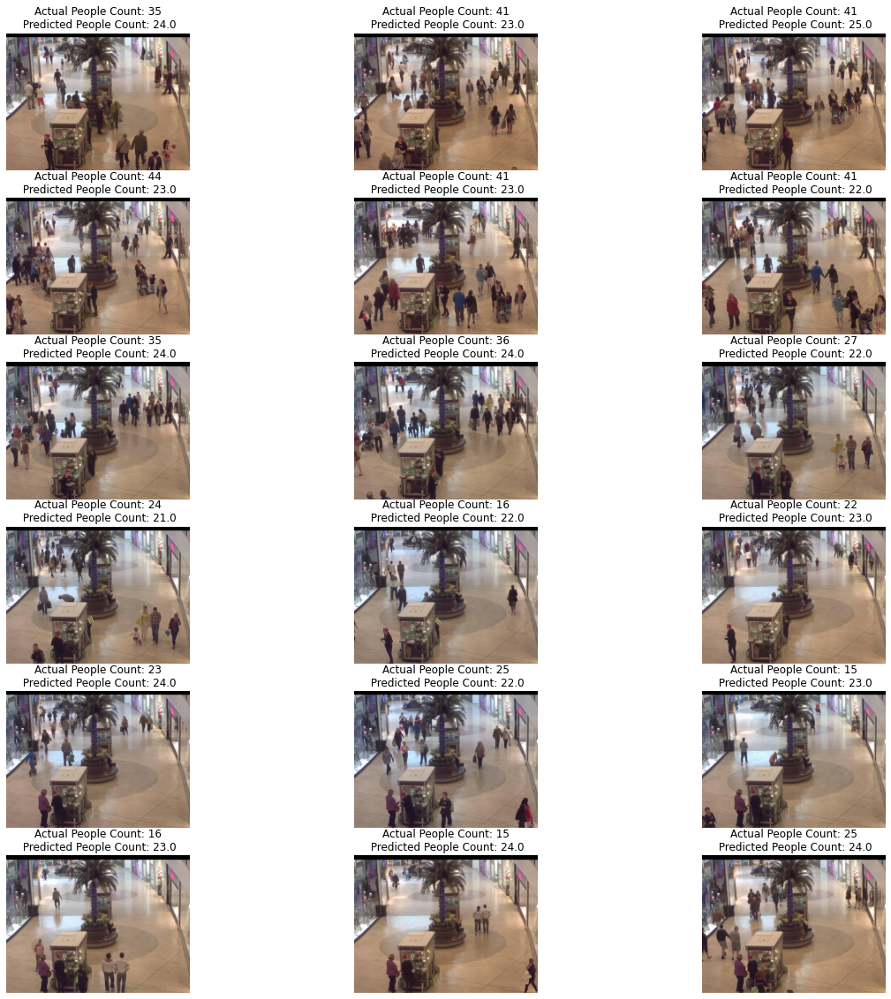

In [79]:
#Print Train Actual vs Predict
plt.figure(figsize=(20, 20))
i=0
for element15 in X_train_org:
    ax = plt.subplot(6, 3, i + 1)
    plt.imshow(element15[0].numpy().astype("uint8"))
    #label = label_batch[i]
    #plt.title("Actual People Count: "+str(Model2_results['actual'][i]))
    plt.title("Actual People Count: "+str(Model2_Train_results['Train_Actual'][i])+ "\n Predicted People Count: "+str(Model2_Train_results['Train_Predicted'][i]))
    plt.axis("off")
    i+=1
    if i>17:
        break
plt.show
    

<function matplotlib.pyplot.show(close=None, block=None)>

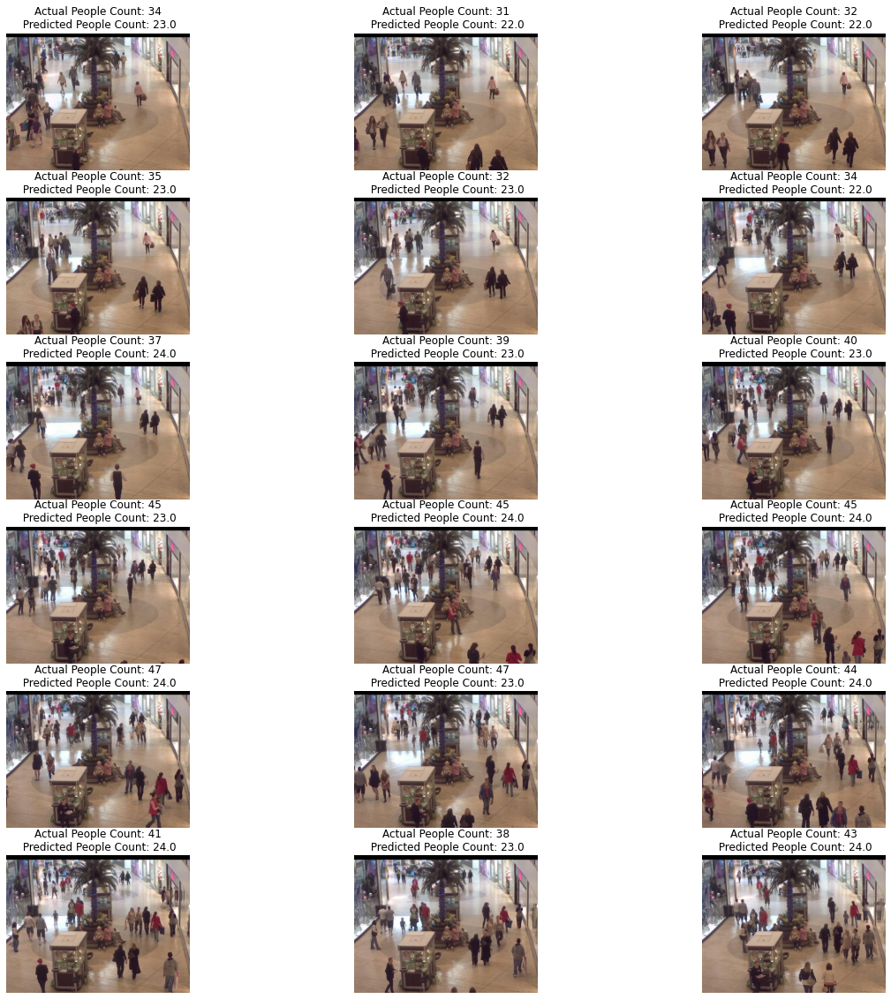

In [80]:
#Print Test Actual vs Predict

plt.figure(figsize=(20, 20))
i=0
for element15 in X_test_org:
    ax = plt.subplot(6, 3, i + 1)
    plt.imshow(element15[0].numpy().astype("uint8"))
    #label = label_batch[i]
    #plt.title("Actual People Count: "+str(Model2_results['actual'][i]))
    plt.title("Actual People Count: "+str(Model2_Test_results['Test_Actual'][i])+ "\n Predicted People Count: "+str(Model2_Test_results['Test_Predicted'][i]))
    plt.axis("off")
    i+=1
    if i>17:
        break
plt.show
    

In [81]:
#Pick top 5 rows which has more prediction margin in Train dataset
Model2_Train_results_sort = Model2_Train_results.sort_values('Train_Difference(actual-predicted)', ascending=False)
Model2_Train_results_sort.head(5)

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,24.0,29.0,180
764,50,23.0,27.0,764
1182,50,23.0,27.0,1182
767,49,23.0,26.0,767
762,49,23.0,26.0,762


In [82]:
Top_least_predicted_Model2 = Model2_Train_results_sort[0:5].sort_values('index_column', ascending=True)

In [83]:
Top_least_predicted_Model2

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,24.0,29.0,180
762,49,23.0,26.0,762
764,50,23.0,27.0,764
767,49,23.0,26.0,767
1182,50,23.0,27.0,1182


### 4.2.1 Pick Best Predictions and Display Images

#### Train Data: Pick Best Predictions and Display Images

In [84]:
#Top_least_predicted_Model2_18 = Model2_Train_results_sort[0:18].sort_values('index_column', ascending=True)
Train_Top_best_predicted_Model2_18 = Model2_Train_results.sort_values('Train_Difference(actual-predicted)', ascending=True)
Train_Top_best_predicted_Model2_18_sort = Train_Top_best_predicted_Model2_18[0:18].sort_values('index_column', ascending=True)
Train_Top_best_predicted_Model2_18_sort.head(18)

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
226,24,24.0,0.0,226
519,23,23.0,0.0,519
521,25,25.0,0.0,521
528,24,24.0,0.0,528
529,24,24.0,0.0,529
530,23,23.0,0.0,530
555,22,22.0,0.0,555
564,23,23.0,0.0,564
565,24,24.0,0.0,565
569,24,24.0,0.0,569


In [85]:
#Train_Top_best_predicted_Model2_18_sort['index_column']

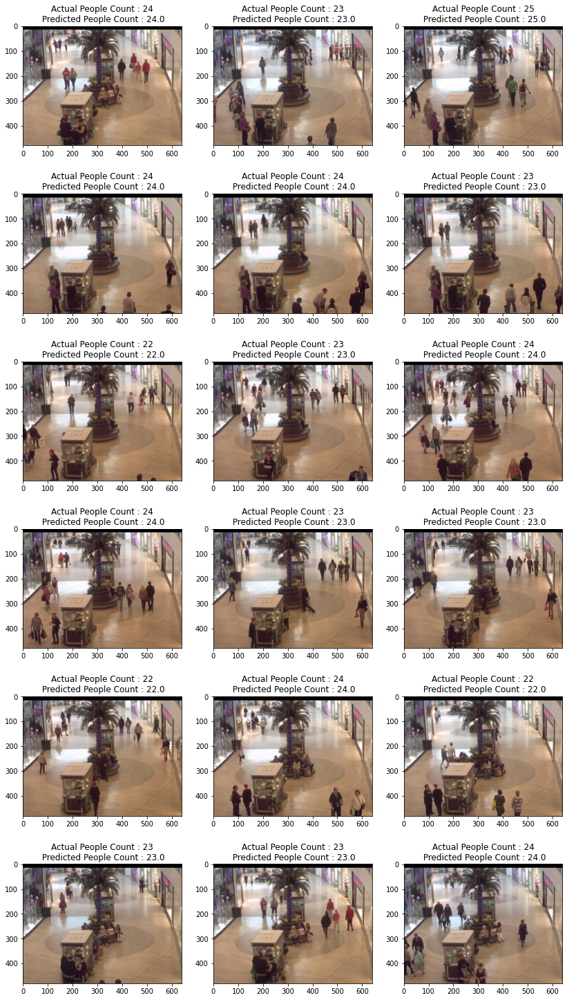

In [86]:
#https://stackoverflow.com/questions/33480297/viewing-npy-images
fig = plt.figure(figsize=(14,26))
a = 6  # number of rows
b = 3 # number of columns
c = 1  # initialize plot counter
for number in Train_Top_best_predicted_Model2_18_sort['index_column']:
    plt.subplot(a, b, c)
    plt.imshow(Crowding_dataset[number], cmap='gray')
    plt.title("Actual People Count : {0}".format(Train_Top_best_predicted_Model2_18_sort['Train_Actual'][number]) + "\n Predicted People Count : {0}".format(Train_Top_best_predicted_Model2_18_sort['Train_Predicted'][number]))
    c=c+1
plt.show()

<b> Observation: </b>
    
Model has predicted correctly (95%) on images which has people count are between 20 and 25

#### Test Data: Pick Best Predictions and Display Images

In [87]:
#Top_least_predicted_Model2_18 = Model2_Test_results_sort[0:18].sort_values('index_column', ascending=True)
Test_Top_best_predicted_Model2_18 = Model2_Test_results.sort_values('Test_Difference(actual-predicted)', ascending=True)
Test_Top_best_predicted_Model2_18_sort = Test_Top_best_predicted_Model2_18[0:18].sort_values('index_column', ascending=True)
Test_Top_best_predicted_Model2_18_sort.head(18)

,Test_Actual,Test_Predicted,Test_Difference(actual-predicted),index_column
66,25,24.0,1.0,66
67,23,23.0,0.0,67
70,25,24.0,1.0,70
160,23,24.0,1.0,160
161,25,24.0,1.0,161
163,26,24.0,2.0,163
164,25,24.0,1.0,164
165,24,22.0,2.0,165
166,22,24.0,2.0,166
167,20,21.0,1.0,167


In [88]:
#Train_Top_best_predicted_Model2_18_sort['index_column']

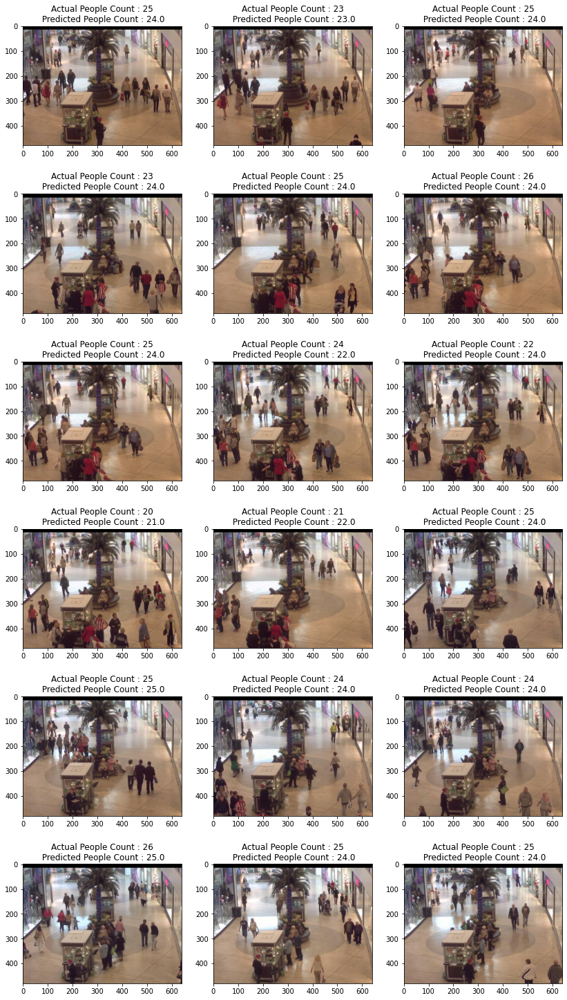

In [89]:
#https://stackoverflow.com/questions/33480297/viewing-npy-images
fig = plt.figure(figsize=(14,26))
a = 6  # number of rows
b = 3 # number of columns
c = 1  # initialize plot counter
for number in Test_Top_best_predicted_Model2_18_sort['index_column']:
    plt.subplot(a, b, c)
    plt.imshow(Crowding_dataset[number], cmap='gray')
    plt.title("Actual People Count : {0}".format(Test_Top_best_predicted_Model2_18_sort['Test_Actual'][number]) + "\n Predicted People Count : {0}".format(Test_Top_best_predicted_Model2_18_sort['Test_Predicted'][number]))
    c=c+1
plt.show()

<b> Observation: </b>
    
Model has predicted correctly (95%) on images which has people count are between 20 and 25

### 4.2.2 Pick Worst Predictions and Display Images

#### Train Data: Pick Worst Predictions and Display Images

In [90]:
#Worst_least_predicted_Model2_18 = Model2_Train_results_sort[0:18].sort_values('index_column', ascending=True)
Train_Worst_best_predicted_Model2_18 = Model2_Train_results.sort_values('Train_Difference(actual-predicted)', ascending=False)
Train_Worst_best_predicted_Model2_18_sort = Train_Worst_best_predicted_Model2_18[0:18].sort_values('index_column', ascending=True)
Train_Worst_best_predicted_Model2_18_sort.head(18)

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
74,48,24.0,24.0,74
180,53,24.0,29.0,180
317,46,21.0,25.0,317
708,47,22.0,25.0,708
719,49,23.0,26.0,719
721,47,22.0,25.0,721
722,50,24.0,26.0,722
725,48,23.0,25.0,725
757,48,23.0,25.0,757
762,49,23.0,26.0,762


In [91]:
#Train_Top_best_predicted_Model2_18_sort['index_column']

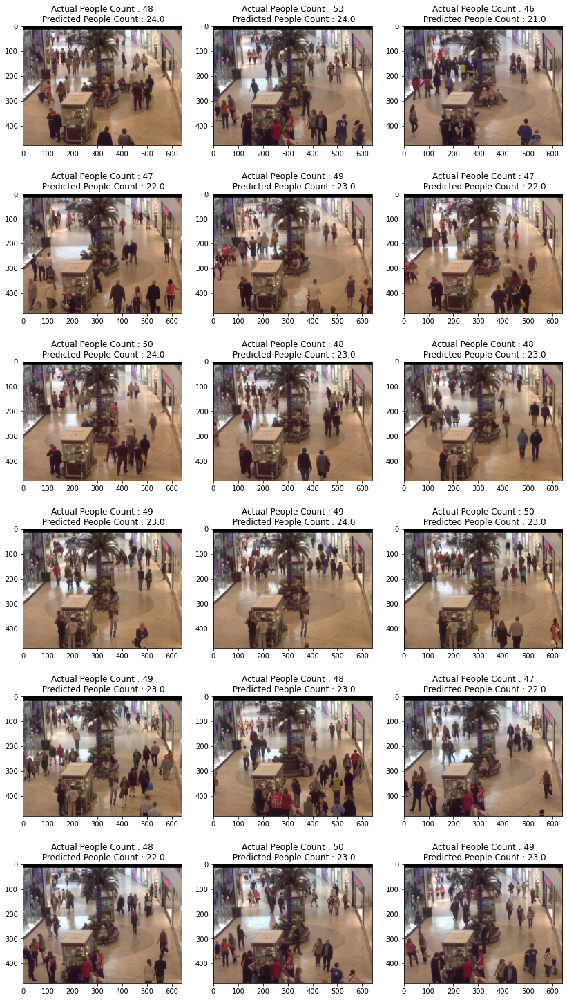

In [92]:
#https://stackoverflow.com/questions/33480297/viewing-npy-images
fig = plt.figure(figsize=(14,26))
a = 6  # number of rows
b = 3 # number of columns
c = 1  # initialize plot counter
for number in Train_Worst_best_predicted_Model2_18_sort['index_column']:
    plt.subplot(a, b, c)
    plt.imshow(Crowding_dataset[number], cmap='gray')
    plt.title("Actual People Count : {0}".format(Train_Worst_best_predicted_Model2_18_sort['Train_Actual'][number]) + "\n Predicted People Count : {0}".format(Train_Worst_best_predicted_Model2_18_sort['Train_Predicted'][number]))
    c=c+1
plt.show()

<b> Observation: </b>
    
Model predicts very badly on the images which has people count >40

#### Test Data: Pick Worst Predictions and Display Images

In [93]:
#Worst_least_predicted_Model2_18 = Model2_Test_results_sort[0:18].sort_values('index_column', ascending=True)
Test_Worst_best_predicted_Model2_18 = Model2_Test_results.sort_values('Test_Difference(actual-predicted)', ascending=False)
Test_Worst_best_predicted_Model2_18_sort = Test_Worst_best_predicted_Model2_18[0:18].sort_values('index_column', ascending=True)
Test_Worst_best_predicted_Model2_18_sort.head(18)

,Test_Actual,Test_Predicted,Test_Difference(actual-predicted),index_column
9,45,23.0,22.0,9
10,45,24.0,21.0,10
11,45,24.0,21.0,11
12,47,24.0,23.0,12
13,47,23.0,24.0,13
53,45,23.0,22.0,53
54,45,24.0,21.0,54
55,47,24.0,23.0,55
56,45,24.0,21.0,56
57,46,24.0,22.0,57


In [94]:
#Train_Top_best_predicted_Model2_18_sort['index_column']

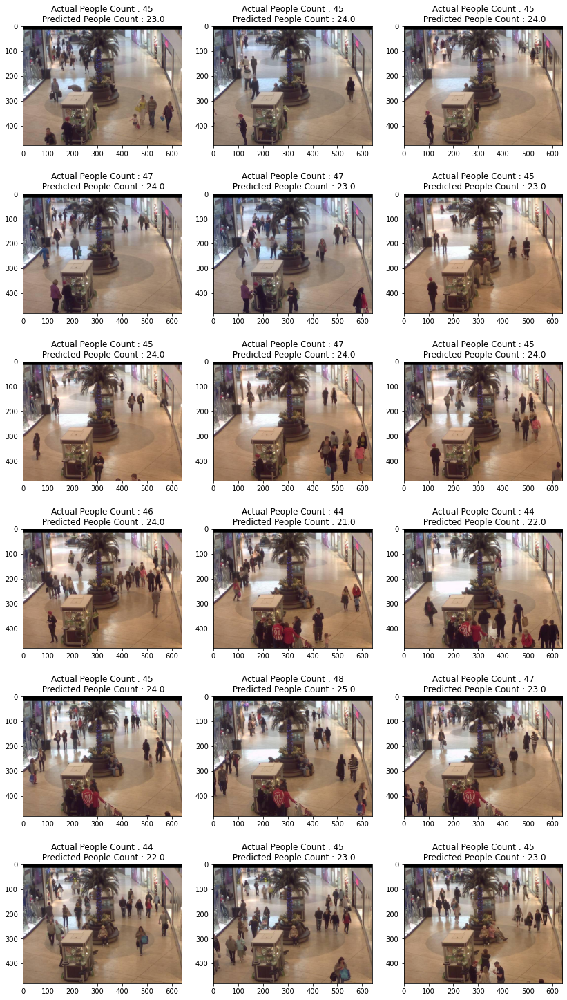

In [95]:
#https://stackoverflow.com/questions/33480297/viewing-npy-images
fig = plt.figure(figsize=(14,26))
a = 6  # number of rows
b = 3 # number of columns
c = 1  # initialize plot counter
for number in Test_Worst_best_predicted_Model2_18_sort['index_column']:
    plt.subplot(a, b, c)
    plt.imshow(Crowding_dataset[number], cmap='gray')
    plt.title("Actual People Count : {0}".format(Test_Worst_best_predicted_Model2_18_sort['Test_Actual'][number]) + "\n Predicted People Count : {0}".format(Test_Worst_best_predicted_Model2_18_sort['Test_Predicted'][number]))
    c=c+1
plt.show()

<b> Observation: </b>
    
Model predicts very badly on the images which has people count >40

### 4.2.3 Post Quantization (Dynamic range quantization)

In [90]:
Model2_forquantization = tf.keras.models.load_model('Model2.h5')

In [91]:
converter = tf.lite.TFLiteConverter.from_keras_model(Model2_forquantization)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
tflite_quant_model = converter.convert()

INFO:tensorflow:Assets written to: C:\Users\Avi\AppData\Local\Temp\tmp8y303_a0\assets


In [92]:
#saving converted model in "converted_quant_model.tflite" file
open("converted_quant_model.tflite", "wb").write(tflite_quant_model)

209424

In [93]:
interpreter = tf.lite.Interpreter(model_path="converted_quant_model.tflite")
interpreter.allocate_tensors()

In [94]:
# Get input and output tensors.
input_details = interpreter.get_input_details()[0]["index"]
output_details = interpreter.get_output_details()[0]["index"]
interpreter.get_input_details()

[{'name': 'conv2d_input',
  'index': 0,
  'shape': array([  1, 400, 400,   3]),
  'shape_signature': array([ -1, 400, 400,   3]),
  'dtype': numpy.float32,
  'quantization': (0.0, 0),
  'quantization_parameters': {'scales': array([], dtype=float32),
   'zero_points': array([], dtype=int32),
   'quantized_dimension': 0},
  'sparsity_parameters': {}}]

In [95]:
X_test_orginal= final_dataset_tf.skip(val_size)
X_test_orginal = X_test_orginal.map(preprocess_image, num_parallel_calls=AUTOTUNE)
batch_size=1
input_shape=(400, 400,3)
X_test_orginal = configure_for_performance(X_test_orginal)
X_test_orginal

<PrefetchDataset shapes: ((None, 400, 400, 3), (None,)), types: (tf.float32, tf.int64)>

In [98]:
from tqdm import tqdm
y_test_quantization_results_model2=[]
# Run predictions on every image in the "test" dataset.

for img, label in tqdm(X_test_orginal.take(50)):
  #expand image dimension to match with input image dimension
  #img = np.expand_dims(img, axis=0)
  #print(img.shape)
  #print(len(img))
  #break
  interpreter.set_tensor(input_details, img)
  # Run inference.
  interpreter.invoke()
  # Post-processing
  predictions  = interpreter.get_tensor(output_details)
  y_test_quantization_results_model2.append(predictions)
  #break


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 50/50 [25:51<00:00, 31.04s/it]


In [125]:
y_test_quantization_results_model2[2][0][0]

24.727335

In [139]:
#Model2_Test_results_withQ.to_csv("Model2_Test_results_withQ.csv")

In [126]:
y_test_quantization_results_model2_final = []
for ikm in range(0,50):
    y_test_quantization_results_model2_final.append(y_test_quantization_results_model2[i][0][0])

y_test_quantization_results_model2_final

[23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361,
 23.433361]

In [133]:
Model2_Test_results_withQ = pd.DataFrame()
Model2_Test_results_withQ.index +=1601

Model2_Test_results_withQ['Test_Actual']= y_test_count_actual[0:50]
Model2_Test_results_withQ['Test_Predicted_WithOutQuantization']= np.round(y_test_results_model2[0:50])
Model2_Test_results_withQ['Test_Predicted_PostQuantization']= np.round(y_test_quantization_results_model2_final)
Model2_Test_results_withQ['index_column'] = Model2_Test_results_withQ.index+1601
Model2_Test_results_withQ.head(5)

,Test_Actual,Test_Predicted_WithOutQuantization,Test_Predicted_PostQuantization,index_column
0,34,24.0,23.0,1601
1,31,22.0,23.0,1602
2,32,23.0,23.0,1603
3,35,23.0,23.0,1604
4,32,23.0,23.0,1605


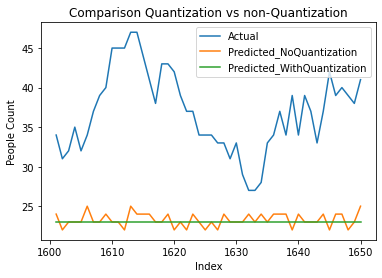

In [134]:
import matplotlib.pyplot as plt

plt.plot(Model2_Test_results_withQ['index_column'],Model2_Test_results_withQ['Test_Actual'],label="Actual")
plt.plot(Model2_Test_results_withQ['index_column'],Model2_Test_results_withQ['Test_Predicted_WithOutQuantization'],label="Predicted_NoQuantization")
plt.plot(Model2_Test_results_withQ['index_column'],Model2_Test_results_withQ['Test_Predicted_PostQuantization'],label="Predicted_WithQuantization")

plt.title('Comparison Quantization vs non-Quantization')
plt.xlabel('Index')
plt.ylabel('People Count')
plt.legend()

plt.show()

<b> Observation: </b>
    
Prediction with Post Quantization provides a same(nearer) score as without Quantization model. However, as shown in above plot, prediction with post quantization provides a average of without quantization score.

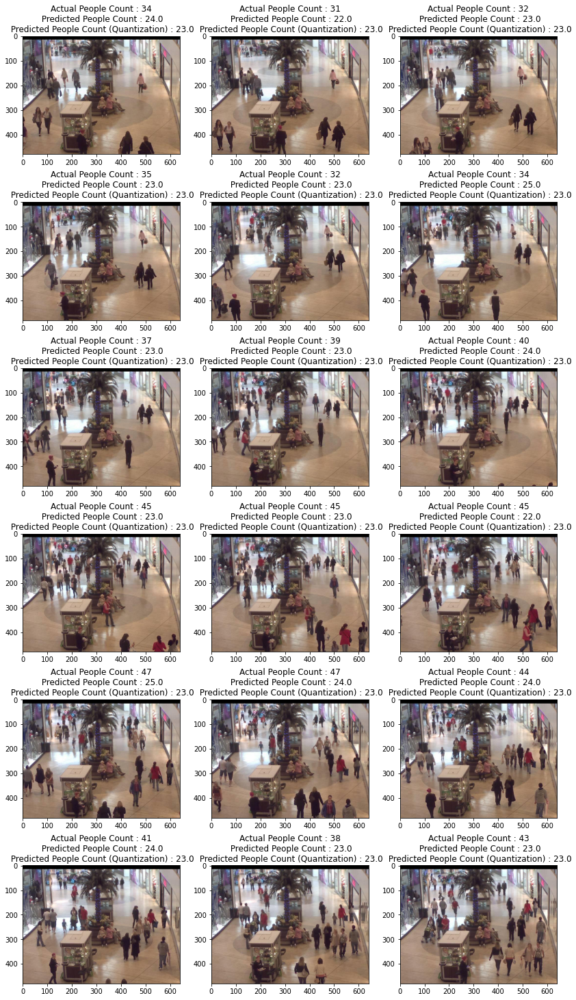

In [135]:
#https://stackoverflow.com/questions/33480297/viewing-npy-images
fig = plt.figure(figsize=(14,26))
a = 6  # number of rows
b = 3 # number of columns
c = 1  # initialize plot counter
for number in range(0,18):
    
    plt.subplot(a, b, c)
    plt.imshow(Crowding_dataset[number+1601], cmap='gray')
    plt.title("Actual People Count : {0}".format(Model2_Test_results_withQ['Test_Actual'][number]) + "\n Predicted People Count : {0}".format(Model2_Test_results_withQ['Test_Predicted_WithOutQuantization'][number])  + "\n Predicted People Count (Quantization) : {0}".format(Model2_Test_results_withQ['Test_Predicted_PostQuantization'][number]) )
    c=c+1
plt.show()

## 5. Apply Sampling

### 5.1 Apply Resampling on Model 1

In [76]:
#pick top least 5 images predicted and sample 5 times each image
train_image_sample_1 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[722]],[Crowding_dataset[763]],[Crowding_dataset[764]],[Crowding_dataset[1182]]])
train_image_sample_2 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[722]],[Crowding_dataset[763]],[Crowding_dataset[764]],[Crowding_dataset[1182]]])
train_image_sample_3 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[722]],[Crowding_dataset[763]],[Crowding_dataset[764]],[Crowding_dataset[1182]]])
train_image_sample_4 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[722]],[Crowding_dataset[763]],[Crowding_dataset[764]],[Crowding_dataset[1182]]])
train_image_sample_5 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[722]],[Crowding_dataset[763]],[Crowding_dataset[764]],[Crowding_dataset[1182]]])

In [80]:
Train_Sample_image_dataset = np.concatenate([train_image_sample_1,train_image_sample_2,train_image_sample_3,train_image_sample_4,train_image_sample_5])
Train_Sample_image_dataset

array([[[[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        ...,

        [[154, 131,  79],
         [152, 129,  79],
         [150, 126,  80],
         ...,
         [201, 158, 124],
         [204, 161, 127],
         [207, 164, 130]],

        [[153, 130,  78],
         [151, 128,  78],
         [149, 125,  77],
         ...,
         [189, 146, 114],
         [193, 150, 118],
         [193, 150, 118]],

        [[155, 132,  78],
         [153, 130,  78],
         [151, 127,  79],
         ...,
         [179, 136, 104],
        

In [81]:
Train_Sample_image_dataset.shape

(25, 480, 640, 3)

In [82]:
Train_Sample_image_dataset.dtype

dtype('uint8')

In [83]:
#Pick top 5 labels and sample 5 times each label
Train_Sample_label_dataset = pd.DataFrame(columns =['count'])
io=0
for im in range (5):
    for ik in range(5):
        Train_Sample_label_dataset.loc[io+1]= Top_least_predicted_Model1.iloc[ik]['Train_Actual']
        io+=1
    #print(lists)

In [84]:
Train_Sample_label_dataset.shape

(25, 1)

In [85]:
Train_Sample_label_dataset

,count
1,53.0
2,50.0
3,49.0
4,50.0
5,50.0
6,53.0
7,50.0
8,49.0
9,50.0
10,50.0


In [86]:
Train_Sample_label_dataset_final = Train_Sample_label_dataset["count"].astype(np.int64)

In [87]:
type(Train_Sample_label_dataset_final)

pandas.core.series.Series

In [88]:
#merge sampled images and labels
final_train_sample_dataset_tf_Model1 = tf.data.Dataset.from_tensor_slices((Train_Sample_image_dataset,Train_Sample_label_dataset_final))

In [89]:
final_train_sample_dataset_tf_Model1

<TensorSliceDataset shapes: ((480, 640, 3), ()), types: (tf.uint8, tf.int64)>

<h2>Splitting data into Train and cross validation(or test)</h2>

In [90]:
val_size = 1600
X_train = final_dataset_tf.take(val_size)
X_test = final_dataset_tf.skip(val_size)

In [ ]:
#X_train_org= final_dataset_tf.take(val_size)
#X_test_org= final_dataset_tf.skip(val_size)

In [91]:
print(tf.data.experimental.cardinality(X_train).numpy())
print(tf.data.experimental.cardinality(X_test).numpy())

1600
400


In [92]:
#merge X_train with sample tf.dataset
X_train = X_train.concatenate(final_train_sample_dataset_tf_Model1)
print(tf.data.experimental.cardinality(X_train).numpy())


1625


In [93]:
y_train_count = []
y_test_count = []
for element2 in X_train:
    y_train_count.append(element2[1])
    #break
    
for element1 in X_test:
    y_test_count.append(element1[1])
    #break
print(y_test_count)

[<tf.Tensor: shape=(), dtype=int64, numpy=34>, <tf.Tensor: shape=(), dtype=int64, numpy=31>, <tf.Tensor: shape=(), dtype=int64, numpy=32>, <tf.Tensor: shape=(), dtype=int64, numpy=35>, <tf.Tensor: shape=(), dtype=int64, numpy=32>, <tf.Tensor: shape=(), dtype=int64, numpy=34>, <tf.Tensor: shape=(), dtype=int64, numpy=37>, <tf.Tensor: shape=(), dtype=int64, numpy=39>, <tf.Tensor: shape=(), dtype=int64, numpy=40>, <tf.Tensor: shape=(), dtype=int64, numpy=45>, <tf.Tensor: shape=(), dtype=int64, numpy=45>, <tf.Tensor: shape=(), dtype=int64, numpy=45>, <tf.Tensor: shape=(), dtype=int64, numpy=47>, <tf.Tensor: shape=(), dtype=int64, numpy=47>, <tf.Tensor: shape=(), dtype=int64, numpy=44>, <tf.Tensor: shape=(), dtype=int64, numpy=41>, <tf.Tensor: shape=(), dtype=int64, numpy=38>, <tf.Tensor: shape=(), dtype=int64, numpy=43>, <tf.Tensor: shape=(), dtype=int64, numpy=43>, <tf.Tensor: shape=(), dtype=int64, numpy=42>, <tf.Tensor: shape=(), dtype=int64, numpy=39>, <tf.Tensor: shape=(), dtype=int64

<h2>Preprocessing</h2>

In [94]:
X_train = X_train.map(preprocess_image, num_parallel_calls=AUTOTUNE)
X_test = X_test.map(preprocess_image, num_parallel_calls=AUTOTUNE)

In [95]:
X_train

<ParallelMapDataset shapes: ((400, 400, 3), ()), types: (tf.float32, tf.int64)>

In [96]:
print(tf.data.experimental.cardinality(X_train).numpy())


1625


In [97]:
for element in X_train:
    print(element[1])
    break

tf.Tensor(35, shape=(), dtype=int64)


In [98]:
#converting to list
y_test_count_actual=[]
for i in range (0,400) :
    y_test_count_actual.append(y_test_count[i].numpy().astype("uint8"))
    
    
#converting to list
y_train_count_actual=[]
for i in range (0,1625) :
    y_train_count_actual.append(y_train_count[i].numpy().astype("uint8"))

In [99]:
len(y_train_count_actual)

1625

In [100]:
X_train = configure_for_performance(X_train)
X_test = configure_for_performance(X_test)

<h2>Load Model and predict the count </h2>

In [101]:
#Input layer
input_layer = Input(shape=input_shape)

#Convolution Parallel layer 1
Conv_Layer_1 = tf.keras.layers.Conv2D(10, kernel_size=(9, 9), padding='same',activation='relu', input_shape=input_shape)(input_layer)
inputlayer_1_pooling = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(Conv_Layer_1)
inputlayer_1_pooling1= tf.keras.layers.Dropout(0.25)(inputlayer_1_pooling)

#Convolution Parallel layer 2
Conv_Layer_2 = tf.keras.layers.Conv2D(14, kernel_size=(7, 7),padding='same',activation='relu', input_shape=input_shape)(input_layer)
inputlayer_2_pooling = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(Conv_Layer_2)
inputlayer_2_pooling1= tf.keras.layers.Dropout(0.25)(inputlayer_2_pooling)

#Convolution Parallel layer 3
Conv_Layer_3 = tf.keras.layers.Conv2D(16, kernel_size=(5, 5),padding='same',activation='relu', input_shape=input_shape)(input_layer)
inputlayer_3_pooling = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(Conv_Layer_3)
inputlayer_3_pooling1= tf.keras.layers.Dropout(0.25)(inputlayer_3_pooling)


In [102]:
#Perform concantenation of all three parallel layers
concatenation_layer = concatenate(inputs=[inputlayer_1_pooling1
                                   ,inputlayer_2_pooling1,inputlayer_3_pooling1
                                  ],name="concat")

In [103]:
#Add 6 convolutional layers as per above architecture

convlayer2 = tf.keras.layers.Conv2D(40, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(concatenation_layer)
convlayer2_1= tf.keras.layers.BatchNormalization()(convlayer2)

convlayer3 = tf.keras.layers.Conv2D(60, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(convlayer2_1)
polling_layer3_1= tf.keras.layers.Dropout(0.25)(convlayer3)
convlayer3_1= tf.keras.layers.BatchNormalization()(polling_layer3_1)
polling_layer3 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(convlayer3_1)


convlayer4 = tf.keras.layers.Conv2D(40, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(polling_layer3)
polling_layer4_1= tf.keras.layers.Dropout(0.25)(convlayer4)
convlayer4_1= tf.keras.layers.BatchNormalization()(polling_layer4_1)
polling_layer4 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(convlayer4_1)


convlayer5 = tf.keras.layers.Conv2D(20, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(polling_layer4)
polling_layer5_1= tf.keras.layers.Dropout(0.25)(convlayer5)
convlayer5_1= tf.keras.layers.BatchNormalization()(polling_layer5_1)


convlayer6 = tf.keras.layers.Conv2D(10, kernel_size=(3,3), padding='same',activation='relu', input_shape=input_shape)(convlayer5_1)
polling_layer6_1= tf.keras.layers.Dropout(0.25)(convlayer6)
convlayer6_1= tf.keras.layers.BatchNormalization()(polling_layer6_1)

flatten = tf.keras.layers.Flatten()(convlayer6_1)
#denss1 = tf.keras.layers.Dense(128, activation=tf.keras.activations.relu)(flatten)
output = tf.keras.layers.Dense(1)(flatten)

In [104]:
from tensorflow.keras.models import Model

final_model = Model(inputs=input_layer,outputs=output)


In [105]:
final_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 400, 400, 3) 0                                            
__________________________________________________________________________________________________
conv2d_11 (Conv2D)              (None, 400, 400, 10) 2440        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_12 (Conv2D)              (None, 400, 400, 14) 2072        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_13 (Conv2D)              (None, 400, 400, 16) 1216        input_2[0][0]                    
____________________________________________________________________________________________

In [106]:
# Compiling the model
final_model.compile(loss='mean_squared_error', optimizer=tf.keras.optimizers.Adam(lr=1e-6), metrics=['mae','mse']
              )

In [107]:
from tensorflow.keras.callbacks import ModelCheckpoint
from time import time
from tensorflow.python.keras.callbacks import TensorBoard
monitor= tf.keras.callbacks.EarlyStopping(monitor=['mae','mse'],patience=5, verbose=1, mode='auto')
checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath="./Model1withsample.hdf5",verbose=1,monitor='val_mae',save_best_only=True,save_freq='epoch')
tensorboard=TensorBoard(log_dir="Model1_withsample_log")


Model1 = final_model.fit(X_train,
          #batch_size=32,
          epochs=epochs,
          verbose=1,
          validation_data=(X_test),
          callbacks=[tensorboard,checkpointer] 
          #callbacks=[ModelCheckpoint('./Model_1.hdf5', monitor='mae', verbose=1,
          #save_best_only=True,  save_freq='epoch')]
            )

Epoch 1/50
51/51 [==============================] - 61s 1s/step - loss: 1014.9188 - mae: 30.9612 - mse: 1014.9188 - val_loss: 1114.4441 - val_mae: 32.8521 - val_mse: 1114.4441

Epoch 00001: val_mae improved from inf to 32.85209, saving model to ./Model1withsample.hdf5
Epoch 2/50
51/51 [==============================] - 42s 822ms/step - loss: 995.4403 - mae: 30.6322 - mse: 995.4403 - val_loss: 1099.3346 - val_mae: 32.6253 - val_mse: 1099.3346

Epoch 00002: val_mae improved from 32.85209 to 32.62527, saving model to ./Model1withsample.hdf5
Epoch 3/50
51/51 [==============================] - 42s 823ms/step - loss: 992.0796 - mae: 30.5898 - mse: 992.0796 - val_loss: 1106.0468 - val_mae: 32.7275 - val_mse: 1106.0468

Epoch 00003: val_mae did not improve from 32.62527
Epoch 4/50
51/51 [==============================] - 42s 821ms/step - loss: 963.3821 - mae: 30.0955 - mse: 963.3821 - val_loss: 1130.8649 - val_mae: 33.1037 - val_mse: 1130.8649

Epoch 00004: val_mae did not improve from 32.6252

In [108]:
final_model.load_weights('./Model1withsample.hdf5')

In [109]:
#Predict the output

y_test_results_model1_Sample = final_model.predict(X_test)
y_train_results_model1_Sample = final_model.predict(X_train)


In [110]:
print(len(y_train_results_model1_Sample))
print(len(y_train_count_actual))

1625
1625


In [111]:
#add predicted results to the dataframe
Model1_Train_Sampleresults = pd.DataFrame()
Model1_Train_Sampleresults['Train_Actual']= y_train_count_actual
Model1_Train_Sampleresults['Train_Predicted']= np.round(y_train_results_model1_Sample)
Model1_Train_Sampleresults['Train_Difference(actual-predicted)']  = Model1_Train_Sampleresults['Train_Actual'] - Model1_Train_Sampleresults['Train_Predicted']
Model1_Train_Sampleresults['index_column'] = Model1_Train_Sampleresults.index

Model1_Test_Sampleresults = pd.DataFrame()
Model1_Test_Sampleresults['Test_Actual']= y_test_count_actual
Model1_Test_Sampleresults['Test_Predicted']= np.round(y_test_results_model1_Sample)
#Model1_Sampleresults['difference'] = y_Test_count_actual-y_Test_Sampleresults_Model1
Model1_Test_Sampleresults['Test_Difference(actual-predicted)']  = Model1_Test_Sampleresults['Test_Actual'] - Model1_Test_Sampleresults['Test_Predicted']
Model1_Test_Sampleresults['index_column'] = Model1_Test_Sampleresults.index
Model1_Test_Sampleresults.head(10)

,Test_Actual,Test_Predicted,Test_Difference(actual-predicted),index_column
0,34,-0.0,34.0,0
1,31,0.0,31.0,1
2,32,0.0,32.0,2
3,35,-1.0,36.0,3
4,32,1.0,31.0,4
5,34,0.0,34.0,5
6,37,1.0,36.0,6
7,39,1.0,38.0,7
8,40,-1.0,41.0,8
9,45,-1.0,46.0,9


In [113]:
#Print prediction for the samples
Model1_Train_sampleresults_sort=pd.DataFrame()
Model1_Train_sampleresults_sort = pd.concat([Model1_Train_Sampleresults[180:181], Model1_Train_Sampleresults[722:723],Model1_Train_Sampleresults[763:764],Model1_Train_Sampleresults[764:765],Model1_Train_Sampleresults[1182:1183]]) 
#df_marks.append(new_row, ignore_index=True)

Model1_Train_sampleresults_sort.head(5)

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,-0.0,53.0,180
722,50,1.0,49.0,722
763,49,0.0,49.0,763
764,50,3.0,47.0,764
1182,50,1.0,49.0,1182


### Comparison between Train data with out Samples vs Train data with Samples

In [114]:
#With out Samples dataset
Top_least_predicted_Model1.head()

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,8.0,45.0,180
722,50,8.0,42.0,722
763,49,7.0,42.0,763
764,50,8.0,42.0,764
1182,50,8.0,42.0,1182


In [115]:
#With Samples dataset
Model1_Train_sampleresults_sort.head()

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,-0.0,53.0,180
722,50,1.0,49.0,722
763,49,0.0,49.0,763
764,50,3.0,47.0,764
1182,50,1.0,49.0,1182


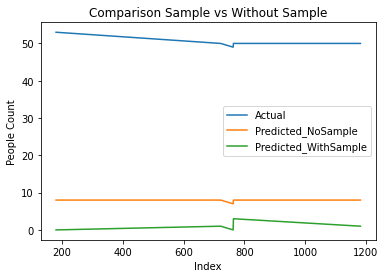

In [116]:
import matplotlib.pyplot as plt

plt.plot(Top_least_predicted_Model1['index_column'],Top_least_predicted_Model1['Train_Actual'],label="Actual")
plt.plot(Top_least_predicted_Model1['index_column'],Top_least_predicted_Model1['Train_Predicted'],label="Predicted_NoSample")
plt.plot(Model1_Train_sampleresults_sort['index_column'],Model1_Train_sampleresults_sort['Train_Predicted'],label="Predicted_WithSample")

plt.title('Comparison Sample vs Without Sample')
plt.xlabel('Index')
plt.ylabel('People Count')
plt.legend()

plt.show()

<b> Observation: </b>
    
Observed that, 
- Train Data after Sampling doesn't show any improvements on prediction. Instead, the predictions become very bad when compared with the predictions with out sampling 

## Tensorboard Model 1 With Sampling

<img src="Model3_Tensorboard.png">

### 5.2 Apply Resampling on Model 2

In [117]:
#pick top least 5 images predicted and sample 5 times each image
train_image_sample_1 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[719]],[Crowding_dataset[722]],[Crowding_dataset[1176]],[Crowding_dataset[1182]]])
train_image_sample_2 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[719]],[Crowding_dataset[722]],[Crowding_dataset[1176]],[Crowding_dataset[1182]]])
train_image_sample_3 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[719]],[Crowding_dataset[722]],[Crowding_dataset[1176]],[Crowding_dataset[1182]]])
train_image_sample_4 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[719]],[Crowding_dataset[722]],[Crowding_dataset[1176]],[Crowding_dataset[1182]]])
train_image_sample_5 = np.concatenate([[Crowding_dataset[180]],[Crowding_dataset[719]],[Crowding_dataset[722]],[Crowding_dataset[1176]],[Crowding_dataset[1182]]])

In [120]:
Train_Sample_image_dataset = np.concatenate([train_image_sample_1,train_image_sample_2,train_image_sample_3,train_image_sample_4,train_image_sample_5])
Train_Sample_image_dataset

array([[[[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        [[  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0],
         ...,
         [  0,   0,   0],
         [  0,   0,   0],
         [  0,   0,   0]],

        ...,

        [[154, 131,  79],
         [152, 129,  79],
         [150, 126,  80],
         ...,
         [201, 158, 124],
         [204, 161, 127],
         [207, 164, 130]],

        [[153, 130,  78],
         [151, 128,  78],
         [149, 125,  77],
         ...,
         [189, 146, 114],
         [193, 150, 118],
         [193, 150, 118]],

        [[155, 132,  78],
         [153, 130,  78],
         [151, 127,  79],
         ...,
         [179, 136, 104],
        

In [121]:
Train_Sample_image_dataset.shape

(25, 480, 640, 3)

In [122]:
Train_Sample_image_dataset.dtype

dtype('uint8')

In [123]:
#Pick top 5 labels and sample 5 times each label
Train_Sample_label_dataset = pd.DataFrame(columns =['count'])
io=0
for im in range (5):
    for ik in range(5):
        Train_Sample_label_dataset.loc[io+1]= Top_least_predicted_Model2.iloc[ik]['Train_Actual']
        io+=1
    #print(lists)

In [124]:
Train_Sample_label_dataset.shape

(25, 1)

In [125]:
Train_Sample_label_dataset

,count
1,53.0
2,49.0
3,50.0
4,48.0
5,50.0
6,53.0
7,49.0
8,50.0
9,48.0
10,50.0


In [ ]:
#Train_Sample_label_dataset.to_csv("Train_Sample_label_dataset.csv")

In [126]:
Train_Sample_label_dataset_final = Train_Sample_label_dataset["count"].astype(np.int64)

In [127]:
type(Train_Sample_label_dataset_final)

pandas.core.series.Series

In [128]:
#merge sampled images and labels
final_train_sample_dataset_tf_Model2 = tf.data.Dataset.from_tensor_slices((Train_Sample_image_dataset,Train_Sample_label_dataset_final))

In [129]:
final_train_sample_dataset_tf_Model2

<TensorSliceDataset shapes: ((480, 640, 3), ()), types: (tf.uint8, tf.int64)>

<h2>Splitting data into Train and cross validation(or test)</h2>

In [130]:
val_size = 1600
X_train = final_dataset_tf.take(val_size)
X_test = final_dataset_tf.skip(val_size)

In [ ]:
#X_train_org= final_dataset_tf.take(val_size)
#X_test_org= final_dataset_tf.skip(val_size)

In [131]:
print(tf.data.experimental.cardinality(X_train).numpy())
print(tf.data.experimental.cardinality(X_test).numpy())

1600
400


In [132]:
#merge X_train with sample tf.dataset
X_train = X_train.concatenate(final_train_sample_dataset_tf_Model2)
print(tf.data.experimental.cardinality(X_train).numpy())


1625


In [133]:
y_train_count = []
y_test_count = []
for element2 in X_train:
    y_train_count.append(element2[1])
    #break
    
for element1 in X_test:
    y_test_count.append(element1[1])
    #break
print(y_test_count)

[<tf.Tensor: shape=(), dtype=int64, numpy=34>, <tf.Tensor: shape=(), dtype=int64, numpy=31>, <tf.Tensor: shape=(), dtype=int64, numpy=32>, <tf.Tensor: shape=(), dtype=int64, numpy=35>, <tf.Tensor: shape=(), dtype=int64, numpy=32>, <tf.Tensor: shape=(), dtype=int64, numpy=34>, <tf.Tensor: shape=(), dtype=int64, numpy=37>, <tf.Tensor: shape=(), dtype=int64, numpy=39>, <tf.Tensor: shape=(), dtype=int64, numpy=40>, <tf.Tensor: shape=(), dtype=int64, numpy=45>, <tf.Tensor: shape=(), dtype=int64, numpy=45>, <tf.Tensor: shape=(), dtype=int64, numpy=45>, <tf.Tensor: shape=(), dtype=int64, numpy=47>, <tf.Tensor: shape=(), dtype=int64, numpy=47>, <tf.Tensor: shape=(), dtype=int64, numpy=44>, <tf.Tensor: shape=(), dtype=int64, numpy=41>, <tf.Tensor: shape=(), dtype=int64, numpy=38>, <tf.Tensor: shape=(), dtype=int64, numpy=43>, <tf.Tensor: shape=(), dtype=int64, numpy=43>, <tf.Tensor: shape=(), dtype=int64, numpy=42>, <tf.Tensor: shape=(), dtype=int64, numpy=39>, <tf.Tensor: shape=(), dtype=int64

<h2>Preprocessing</h2>

In [134]:
X_train = X_train.map(preprocess_image, num_parallel_calls=AUTOTUNE)
X_test = X_test.map(preprocess_image, num_parallel_calls=AUTOTUNE)

In [135]:
X_train

<ParallelMapDataset shapes: ((400, 400, 3), ()), types: (tf.float32, tf.int64)>

In [136]:
print(tf.data.experimental.cardinality(X_train).numpy())


1625


In [137]:
for element in X_train:
    print(element[1])
    break

tf.Tensor(35, shape=(), dtype=int64)


In [138]:
#converting to list
y_test_count_actual=[]
for i in range (0,400) :
    y_test_count_actual.append(y_test_count[i].numpy().astype("uint8"))
    
    
#converting to list
y_train_count_actual=[]
for i in range (0,1625) :
    y_train_count_actual.append(y_train_count[i].numpy().astype("uint8"))

In [139]:
len(y_train_count_actual)

1625

In [140]:
X_train = configure_for_performance(X_train)
X_test = configure_for_performance(X_test)

<h2>Load Model and predict the count </h2>

In [141]:
model = tf.keras.Sequential()
model.add(tf.keras.layers.Conv2D(32, kernel_size=(3, 3),
                 activation='relu',
                 input_shape=input_shape))


model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))

model.add(tf.keras.layers.Dense(64, activation='relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.5))

model.add(tf.keras.layers.Conv2D(128, (3, 3), activation='relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.25))


model.add(tf.keras.layers.Dense(128, activation='relu'))
model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
model.add(tf.keras.layers.BatchNormalization())
model.add(tf.keras.layers.Dropout(0.5))


model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(1))


In [142]:
model.compile(loss='mean_squared_error', optimizer=tf.keras.optimizers.Adam(lr=1e-6), metrics=['mae','mse']
              )

In [143]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_19 (Conv2D)           (None, 398, 398, 32)      896       
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 396, 396, 64)      18496     
_________________________________________________________________
max_pooling2d_14 (MaxPooling (None, 198, 198, 64)      0         
_________________________________________________________________
batch_normalization_14 (Batc (None, 198, 198, 64)      256       
_________________________________________________________________
dropout_18 (Dropout)         (None, 198, 198, 64)      0         
_________________________________________________________________
dense_5 (Dense)              (None, 198, 198, 64)      4160      
_________________________________________________________________
max_pooling2d_15 (MaxPooling (None, 99, 99, 64)       

In [144]:
from tensorflow.keras.callbacks import ModelCheckpoint


from tensorflow.keras.callbacks import ModelCheckpoint
from time import time
from tensorflow.python.keras.callbacks import TensorBoard
#monitor= tf.keras.callbacks.EarlyStopping(monitor=['mae'],patience=5, verbose=1, mode='auto')
checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath="./Model2withsample.hdf5",verbose=1,monitor='val_mae',save_best_only=True,save_freq='epoch')
tensorboard=TensorBoard(log_dir="Model2withsample_log")


Model_2 = model.fit(X_train,
          #batch_size=32,
          epochs=epochs,
          verbose=1,
          validation_data=(X_test),
          callbacks=[tensorboard,checkpointer] 
          #callbacks=[ModelCheckpoint('./Model_2.hdf5', monitor='mae', verbose=1,
          #save_best_only=True,  save_freq='epoch')]
            )

Epoch 1/50
51/51 [==============================] - 64s 1s/step - loss: 960.9636 - mae: 30.0122 - mse: 960.9636 - val_loss: 1116.2307 - val_mae: 32.8775 - val_mse: 1116.2307

Epoch 00001: val_mae improved from inf to 32.87753, saving model to ./Model2withsample.hdf5
Epoch 2/50
51/51 [==============================] - 47s 931ms/step - loss: 881.4278 - mae: 28.7168 - mse: 881.4278 - val_loss: 1035.4279 - val_mae: 31.6273 - val_mse: 1035.4279

Epoch 00002: val_mae improved from 32.87753 to 31.62731, saving model to ./Model2withsample.hdf5
Epoch 3/50
51/51 [==============================] - 47s 932ms/step - loss: 819.5737 - mae: 27.5746 - mse: 819.5737 - val_loss: 960.7562 - val_mae: 30.4218 - val_mse: 960.7562

Epoch 00003: val_mae improved from 31.62731 to 30.42183, saving model to ./Model2withsample.hdf5
Epoch 4/50
51/51 [==============================] - 48s 934ms/step - loss: 761.7595 - mae: 26.4669 - mse: 761.7595 - val_loss: 901.1843 - val_mae: 29.4258 - val_mse: 901.1843

Epoch 000

In [145]:
model.load_weights('./Model2withsample.hdf5')

In [146]:
#Predict the output

y_test_results_model2_Sample = model.predict(X_test)
y_train_results_model2_Sample = model.predict(X_train)


In [147]:

print(len(y_train_results_model2_Sample))
print(len(y_train_count_actual))

1625
1625


In [148]:
#add predicted results to the dataframe
Model2_Train_Sampleresults = pd.DataFrame()
Model2_Train_Sampleresults['Train_Actual']= y_train_count_actual
Model2_Train_Sampleresults['Train_Predicted']= np.round(y_train_results_model2_Sample)
Model2_Train_Sampleresults['Train_Difference(actual-predicted)']  = Model2_Train_Sampleresults['Train_Actual'] - Model2_Train_Sampleresults['Train_Predicted']
Model2_Train_Sampleresults['index_column'] = Model2_Train_Sampleresults.index

Model2_Test_Sampleresults = pd.DataFrame()
Model2_Test_Sampleresults['Test_Actual']= y_test_count_actual
Model2_Test_Sampleresults['Test_Predicted']= np.round(y_test_results_model2_Sample)
#Model2_Sampleresults['difference'] = y_Test_count_actual-y_Test_Sampleresults_Model2
Model2_Test_Sampleresults['Test_Difference(actual-predicted)']  = Model2_Test_Sampleresults['Test_Actual'] - Model2_Test_Sampleresults['Test_Predicted']
Model2_Test_Sampleresults['index_column'] = Model2_Test_Sampleresults.index
Model2_Test_Sampleresults.head(10)

,Test_Actual,Test_Predicted,Test_Difference(actual-predicted),index_column
0,34,20.0,14.0,0
1,31,20.0,11.0,1
2,32,21.0,11.0,2
3,35,20.0,15.0,3
4,32,20.0,12.0,4
5,34,20.0,14.0,5
6,37,20.0,17.0,6
7,39,20.0,19.0,7
8,40,21.0,19.0,8
9,45,22.0,23.0,9


In [150]:
#Print prediction for the samples
Model2_Train_sampleresults_sort=pd.DataFrame()
Model2_Train_sampleresults_sort = pd.concat([Model2_Train_Sampleresults[180:181], Model2_Train_Sampleresults[719:720],Model2_Train_Sampleresults[722:723],Model2_Train_Sampleresults[1176:1177],Model2_Train_Sampleresults[1182:1183]]) 
#df_marks.append(new_row, ignore_index=True)

Model2_Train_sampleresults_sort.head(5)

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,20.0,33.0,180
719,49,20.0,29.0,719
722,50,20.0,30.0,722
1176,48,23.0,25.0,1176
1182,50,19.0,31.0,1182


### Comparison between Train data with out Samples vs Train data with Samples

In [151]:
#With out Samples dataset
Top_least_predicted_Model2.head()

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,22.0,31.0,180
719,49,21.0,28.0,719
722,50,22.0,28.0,722
1176,48,21.0,27.0,1176
1182,50,22.0,28.0,1182


In [152]:
#With Samples dataset
Model2_Train_sampleresults_sort.head()

,Train_Actual,Train_Predicted,Train_Difference(actual-predicted),index_column
180,53,20.0,33.0,180
719,49,20.0,29.0,719
722,50,20.0,30.0,722
1176,48,23.0,25.0,1176
1182,50,19.0,31.0,1182


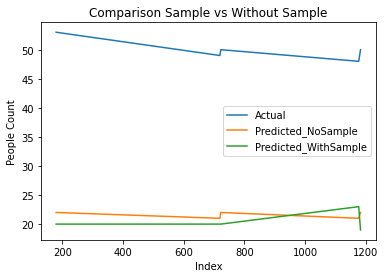

In [153]:
import matplotlib.pyplot as plt

plt.plot(Top_least_predicted_Model2['index_column'],Top_least_predicted_Model2['Train_Actual'],label="Actual")
plt.plot(Top_least_predicted_Model2['index_column'],Top_least_predicted_Model2['Train_Predicted'],label="Predicted_NoSample")
plt.plot(Model2_Train_sampleresults_sort['index_column'],Model2_Train_sampleresults_sort['Train_Predicted'],label="Predicted_WithSample")

plt.title('Comparison Sample vs Without Sample')
plt.xlabel('Index')
plt.ylabel('People Count')
plt.legend()

plt.show()

<b> Observation: </b>
    
Observed that, 
- There is a slight increase of prediction for the Image under index 1176.
- Train Data with sampling Predictions are really bad  when compared with Train Data with out sampling predictions for indexes 180, 719, 722 and 1182

Model 2 provided better predictions for Sampling dataset when compared with Model 1

## Tensorboard Model 2 with Sampling

<img src="Model1_Tensorboard.png">